In [1]:
import os
import sys
sys.path.append('/mnt/mnt/5TB_slot2/Tobias')
sys.path.append('/mnt/mnt/5TB_slot2/Tobias/TobiasPy/fastMRI')
sys.path.append('/mnt/mnt/4TB_pcie/fastBrain/')
import h5py
import numpy as np
import numpy.fft as nf
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from models.unet.unet_model import UnetModel as UnetModel
from FF_net import FF_net
from FF_net import FF_simple_net
from FF_net import FF_net_tanh
from FF_net import Complex_net
import argparse
from common.args import Args
import models.unet.run_unet  as Run
import torch.nn as nn
import logging
import pathlib
import random
from torch.utils.data import Dataset
import time
from torch.nn import functional as F
import shutil
from tensorboardX import SummaryWriter
import torchvision
from torchvision import transforms, utils
import net_utils as nu
import calendar
import datetime
from longOne import ComplexFourier

import sigpy as sp
import sigpy.plot as pl
import vd_spiral

from FF_net import Complex_net_ext

%load_ext autoreload
%autoreload 2

In [2]:
sys.argv=['']
def create_arg_parser():
    timestamp = calendar.timegm(time.gmtime())
    human_readable = datetime.datetime.fromtimestamp(timestamp).isoformat()
    #human_readable="pure_inverse_fourier"
    parser = argparse.ArgumentParser(description="ML parameters")
    parser.add_argument('--num-pools', type=int, default=4, help='Number of U-Net pooling layers')
    parser.add_argument('--drop-prob', type=float, default=0.0, help='Dropout probability')
    parser.add_argument('--num-chans', type=int, default=32, help='Number of U-Net channels')

    parser.add_argument('--batch-size', default=16, type=int, help='Mini batch size')
    parser.add_argument('--num-epochs', type=int, default=1000, help='Number of training epochs')
    parser.add_argument('--lr', type=float, default=0.0001, help='Learning rate')
    parser.add_argument('--lr-step-size', type=int, default=100,
                        help='Period of learning rate decay')
    parser.add_argument('--lr-gamma', type=float, default=0.1,
                        help='Multiplicative factor of learning rate decay')
    parser.add_argument('--weight-decay', type=float, default=0.01,
                        help='Strength of weight decay regularization')
    parser.add_argument('--momentum', type=float, default=0.1,
                        help='Strength of optimizer momentum')

    parser.add_argument('--report-interval', type=int, default=10000, help='Period of loss reporting')
    parser.add_argument('--data-parallel', default=True,
                        help='If set, use multiple GPUs using data parallelism')
    parser.add_argument('--device', type=str, default='cuda',
                        help='Which device to train on. Set to "cuda" to use the GPU')
    parser.add_argument('--exp-dir', type=pathlib.Path, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable),
                        help='Path where model and results should be saved')
    parser.add_argument('--resume', action='store_true', default=False,
                        help='If set, resume the training from a previous model checkpoint. '
                             '"--checkpoint" should be set with this')
    parser.add_argument('--checkpoint', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_'+str(human_readable)+'/best_model.pt',
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--logdir', type=str, default='/mnt/mnt/5TB_slot2/Tobias/Thesis/log/ff_lrelu_'+str(human_readable),
                        help='Path to an existing checkpoint. Used along with "--resume"')
    parser.add_argument('--seed', default=42, type=int, help='Seed for random number generators')
    parser.add_argument('--resolution', default=256, type=int, help='Resolution of images')
    parser.add_argument('--device_ids', default=[2,3] , help='GPUS used')
    return parser
args=create_arg_parser().parse_args()

In [3]:
def test_fourier():
    sig = np.random.randn(args.resolution) + 1j*np.random.randn(320)
    F = np.fft.ifft(sig, axis=-1)
    # First half of inputs/outputs is real part, second half is imaginary part
    X = torch.from_numpy(np.hstack([sig.real, sig.imag])).double()
    Y = torch.from_numpy((F.real**2+F.imag**2)**(1/2)).double()
    return X,Y

class SliceData(Dataset):
    """
    A PyTorch Dataset that provides access to MR image slices.
    """
    
    def __init__(self, root="/mnt/mnt/5TB_slot2/fastMRI/multicoil_train", sample_rate=1.):
        self.examples = []
        #potential to apply pre-process transform
        files = list(pathlib.Path(root).iterdir())
        if sample_rate < 1:
            #random.shuffle(files)
            num_files = round(len(files) * sample_rate)
            files = files[:num_files]
        for fname in sorted(files):
            print(fname)
            try:
                #print(h5py.File(fname, 'r').keys())
                #maybe also only randomly select parts of slices. Otherwise lot of outer noise-like structures.
                xml = h5py.File(fname, 'r')['ismrmrd_header']
                kspace = h5py.File(fname, 'r')['kspace']
                num_slices = kspace.shape[0]
                num_channels=kspace.shape[1]
                if (kspace.shape[-2]<args.resolution) or (kspace.shape[-1]<args.resolution):# or num_channels!=16:
                    continue
                print(len(self.examples))
                for slice in range(num_slices):
                    crop_size = (min(args.resolution, kspace.shape[-2]),min(args.resolution, kspace.shape[-1]))
                    k=nu.center_crop(kspace[slice], crop_size)[0]
                    target=abs(nu.make_ift(k))
                    m=np.max(target)
                    if m>0:
                        target/=m
                    else:
                        continue
                    full=k#*args.resolution
                    full/=m
                    if np.isnan(np.sum(full)) or np.isnan(np.sum(target)):
                        continue
                    X=nu.to_tensor(full).unsqueeze(0)#.flatten()
                    #print(X.shape)
                    Y=nu.to_tensor(target)
                    #print(Y.shape)
                    #X,Y=test_fourier()
                    self.examples += [(fname, slice, X, Y)]
            except:
                print("Couldn't open file")
    
    def __len__(self):
        return len(self.examples)
    
    def __getitem__(self, i):
        fname, slice, f, t = self.examples[i]
#         with h5py.File(fname, 'r') as data:
#             full=to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, full.shape[-3]),min(args.resolution, full.shape[-2]))          
#             full=complex_center_crop(full,crop_size)
            
#             kspace = to_tensor(data['kspace'][slice])
#             crop_size = (min(args.resolution, kspace.shape[-3]), min(args.resolution, kspace.shape[-2]))
#             kspace=apply_mask(kspace)[0]
#             kspace = complex_center_crop(kspace, crop_size)
            
        return (f, t)

In [4]:
def create_data_loaders():
    #batch_size=32
    #mask_func = None
    #if args.mask_kspace:
    #    mask_func = MaskFunc(args.center_fractions, args.accelerations)
    train_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_train",sample_rate=0.05)
    dev_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    test_data = SliceData(root="/mnt/mnt/4TB_pcie/fastBrain/multicoil_test_brain",sample_rate=0.05)
    train_loader = DataLoader(
        dataset=train_data,
        batch_size=args.batch_size,
        shuffle=False,#
        num_workers=0,
        pin_memory=True,
    )
    dev_loader = DataLoader(
        dataset=dev_data,
        batch_size=args.batch_size,
        num_workers=0,
        pin_memory=True,
    )
    test_loader=None
#     test_loader = DataLoader(
#         dataset=test_data,
#         num_workers=0,
#         pin_memory=True,
#     )
    return train_loader, dev_loader, test_loader

In [5]:
t=time.time()
train_loader, dev_loader, test_loader= create_data_loaders()
print("Time taken to load data: ",time.time()-t)

/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002496.h5
0
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002506.h5
16
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002553.h5
32
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_200_6002570.h5
48
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002938.h5
64
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6002963.h5
80
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003005.h5
94
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003016.h5
110
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_201_6003027.h5
126
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000480.h5
138
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_202_6000585.h5
154
/mnt/mnt/4TB_pcie/fastBrain/multicoil_train/file_brain_AXFLAIR_203_6000898.h5
/mnt/mnt/4TB_pcie/fastBrain/

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


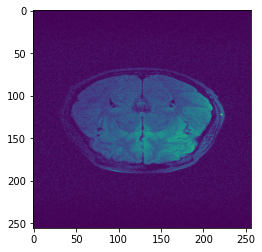

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


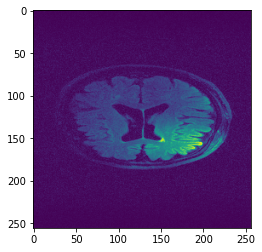

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


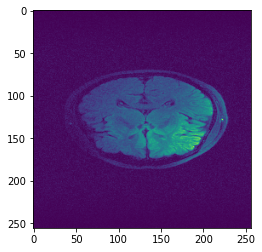

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


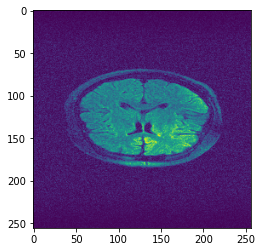

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


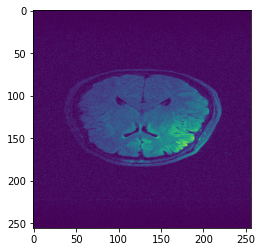

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


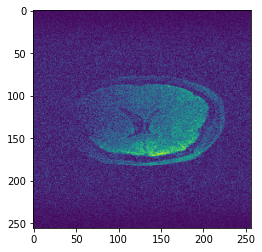

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


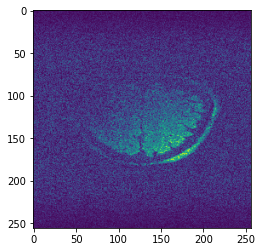

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


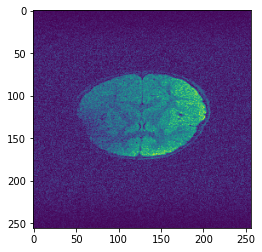

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


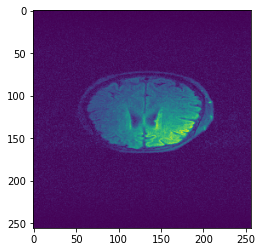

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


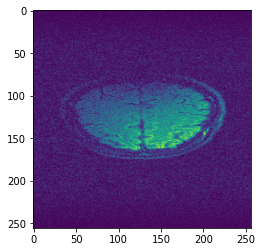

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


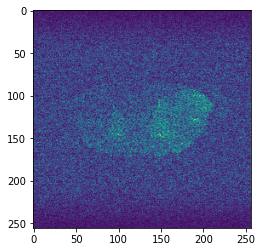

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


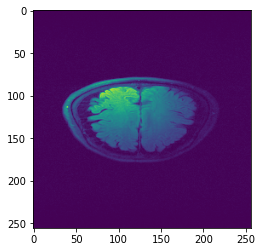

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


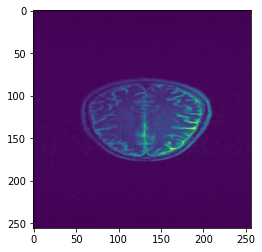

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


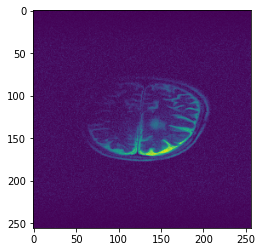

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


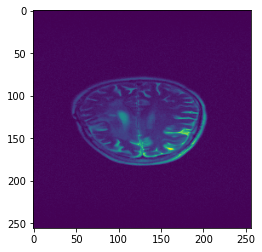

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


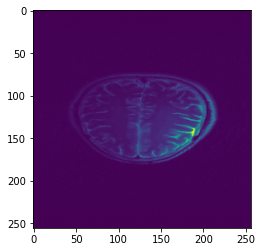

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


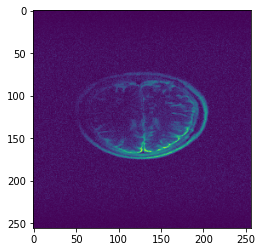

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


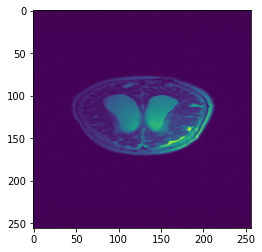

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


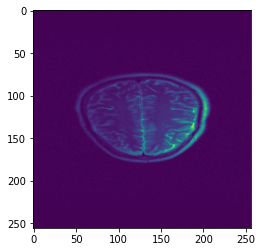

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


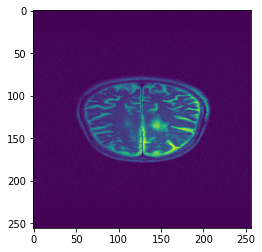

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


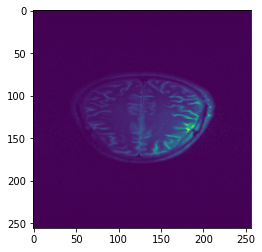

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


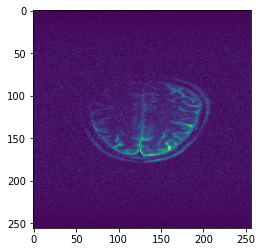

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


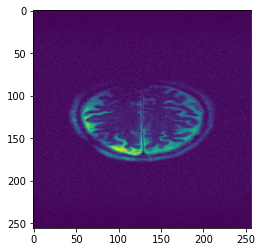

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


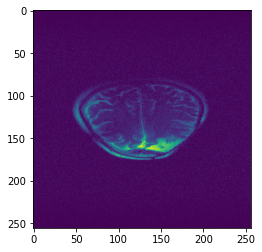

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


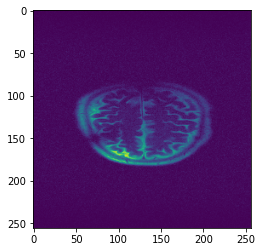

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


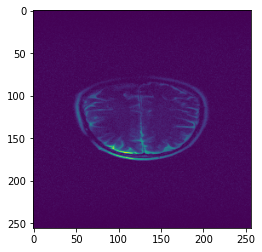

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


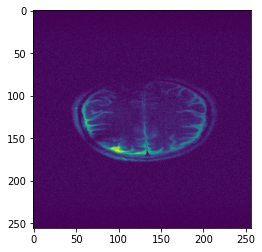

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


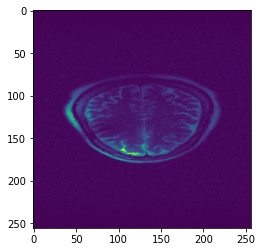

torch.Size([16, 1, 256, 256, 2]) torch.Size([16, 256, 256])


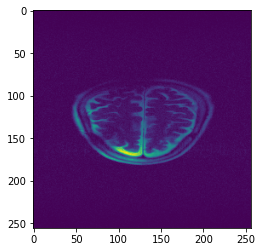

torch.Size([8, 1, 256, 256, 2]) torch.Size([8, 256, 256])


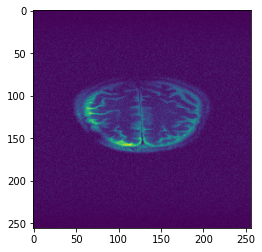

In [6]:
with torch.no_grad():
        for (f, t) in train_loader:
            print(f.shape,t.shape)
            plt.imshow(t[0,:,:])
            plt.show()

In [7]:
def build_model(args,chans=32,num_pool_layers=4,drop_prob=0.05):
    #check every time which gpus are available!
    #device_ids=[2,3,1]
    device_ids=args.device_ids
    model=ComplexFourier(in_chans=1, out_chans=1, drop_prob=0, resolution=args.resolution).to(f'{args.device}:{args.device_ids[0]}')
    model=model.double()
    if args.data_parallel and args.device=="cuda":
        model = nn.DataParallel(model,device_ids=device_ids)
    print("Model build successfully")
    #vis_weights(model)
    return model

def vis_weights(model):
    for name, param in model.named_parameters():
        if param.requires_grad:
            print(name, param.data)
            # Heat map of neuron weights
            plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
            plt.show()
#            fig,ax=plt.subplots(320,1,figsize=(16,16))
#             for i in range(320):
#                 ax[i].plot(param.data.cpu()[i,:320])
#             plt.show()

def build_optim(args,params):
    optimizer = torch.optim.Adadelta(params)
    return optimizer

def load_model(checkpoint_file,args):
    checkpoint = torch.load(checkpoint_file)
    args = checkpoint['args']
    model = build_model(args)
    model.load_state_dict(checkpoint['model'])

    optimizer = build_optim(args, model.parameters())
    optimizer.load_state_dict(checkpoint['optimizer'])
    print("Model load successfully")
    return checkpoint, model, optimizer

def save_model(args, exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best):
    torch.save(
        {
            'epoch': epoch,
            'args': args,
            'model': model.state_dict(),
            'optimizer': optimizer.state_dict(),
            'best_dev_loss': best_dev_loss,
            'exp_dir': exp_dir
        },
        f=exp_dir / 'model.pt'
    )
    if is_new_best:
        shutil.copyfile(exp_dir / 'model.pt', exp_dir / 'best_model.pt')
        
def visualize(args, epoch, model, data_loader, writer):
    def save_image(image, tag):
        image -= image.min()
        image /= image.max()
        grid = torchvision.utils.make_grid(image, nrow=4, pad_value=1)
        writer.add_image(tag, grid, epoch)
    model.eval()
    
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            input, target = data
            input = input.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            target = target.unsqueeze(1).to(f'{args.device}:{args.device_ids[0]}')
            output = model(input)
            save_image(target[0,:,:], 'Target')
            save_image(output[0,:,:], 'Reconstruction')
            save_image(torch.abs(target - output)[0,:,:], 'Error')
            break

In [8]:
def train_epoch(args, epoch, model, data_loader, optimizer, writer):
    model.train()
    avg_loss = 0.
    start_epoch = start_iter = time.perf_counter()
    global_step = epoch * len(data_loader)
    for iter, data in enumerate(data_loader):
        f, t = data
        input = f.to(f'{args.device}:{model.device_ids[0]}')
        target = t.to(f'{args.device}:{model.device_ids[0]}')
        output = model(input).squeeze(1)
        
        loss = F.mse_loss(output, target)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        avg_loss = 0.99 * avg_loss + 0.01 * loss.item() if iter > 0 else loss.item()
        writer.add_scalar('TrainLoss', loss.item(), global_step + iter)

#         if iter % args.report_interval == 0:
#             print(f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] ',
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] ',
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} ',
#                 f'Time = {time.perf_counter() - start_iter:.4f}s')
#             logging.info(
#                 f'Epoch = [{epoch:3d}/{args.num_epochs:3d}] '
#                 f'Iter = [{iter:4d}/{len(data_loader):4d}] '
#                 f'Loss = {loss.item():.4g} Avg Loss = {avg_loss:.4g} '
#                 f'Time = {time.perf_counter() - start_iter:.4f}s',
#             )
        start_iter = time.perf_counter()
    return avg_loss, time.perf_counter() - start_epoch

def evaluate(args, epoch, model, data_loader, writer):
    model.eval()
    losses = []
    start = time.perf_counter()
    with torch.no_grad():
        for iter, data in enumerate(data_loader):
            f, t = data
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)

            #mean = mean.unsqueeze(1).unsqueeze(2).to(args.device)
            #std = std.unsqueeze(1).unsqueeze(2).to(args.device)
            #target = target * std + mean
            #output = output * std + mean

            #norm = norm.unsqueeze(1).unsqueeze(2).to(args.device)
            #loss = F.mse_loss(output / norm, target / norm, size_average=False)
            loss = F.mse_loss(output, target)
            losses.append(loss.item())
        writer.add_scalar('Dev_Loss', np.mean(losses), epoch)
        print('Dev_Loss', np.mean(losses),'Epoch', epoch)
    return np.mean(losses), time.perf_counter() - start

Model build successfully


/opt/conda/lib/python3.6/site-packages/torch/optim/lr_scheduler.py:143: UserWarning: The epoch parameter in `scheduler.step()` was not necessary and is being deprecated where possible. Please use `scheduler.step()` to step the scheduler. During the deprecation, if epoch is different from None, the closed form is used instead of the new chainable form, where available. Please open an issue if you are unable to replicate your use case: https://github.com/pytorch/pytorch/issues/new/choose.
  warnings.warn(EPOCH_DEPRECATION_WARNING, UserWarning)


in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

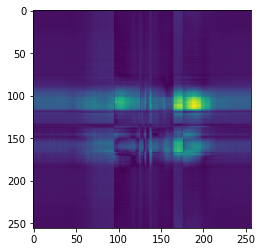

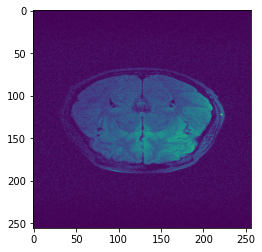

Time taken for epoch:  6.337111949920654
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

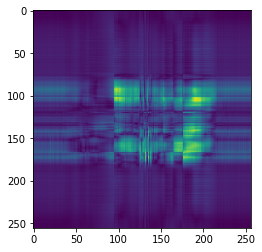

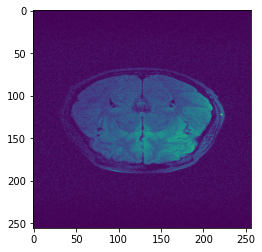

Time taken for epoch:  2.8999438285827637
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

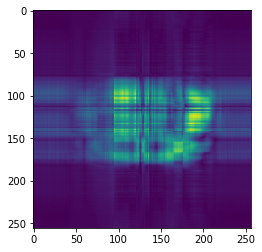

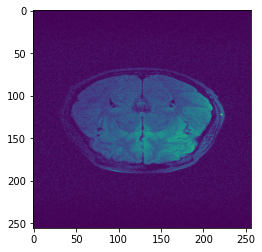

Time taken for epoch:  2.896733283996582
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

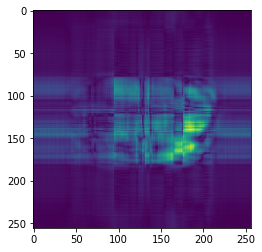

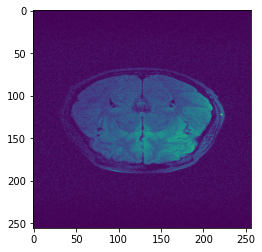

Time taken for epoch:  2.914038896560669
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

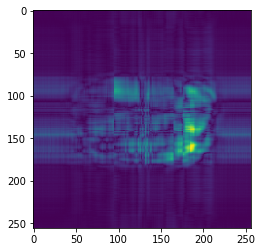

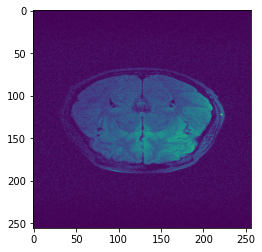

Time taken for epoch:  3.7538018226623535
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

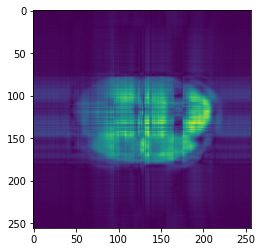

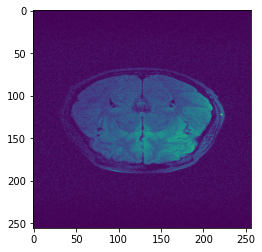

Time taken for epoch:  3.162400484085083
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

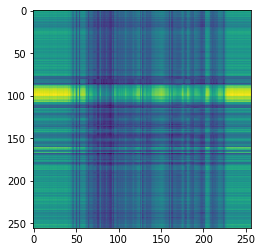

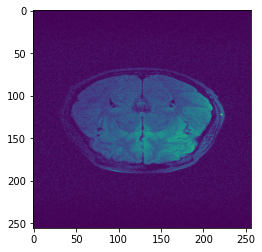

Time taken for epoch:  2.97127103805542
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

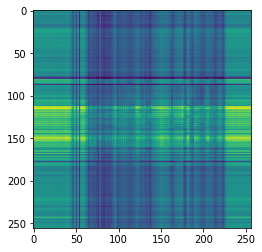

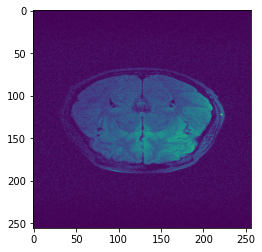

Time taken for epoch:  3.856741428375244
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 in torch.Size([8, 1, 256, 256])
torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

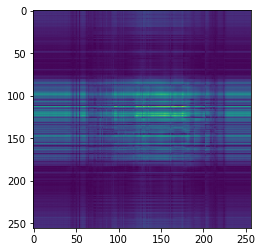

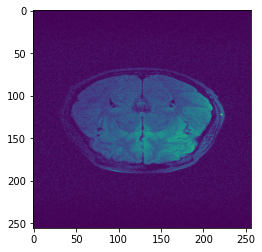

Time taken for epoch:  2.8634631633758545
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

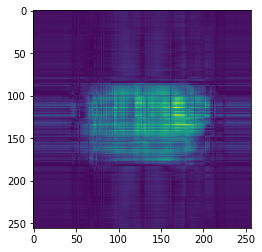

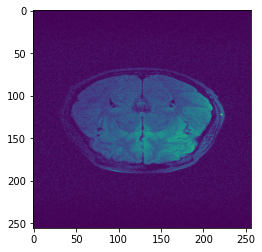

Time taken for epoch:  3.268125295639038
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

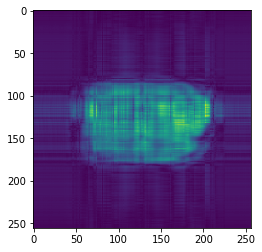

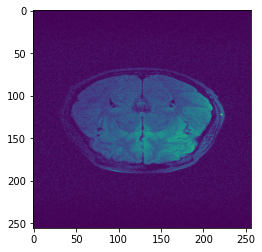

Time taken for epoch:  3.0651469230651855
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
outout2 torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

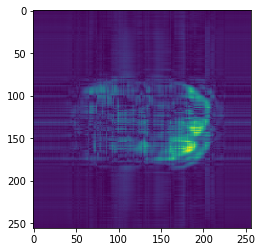

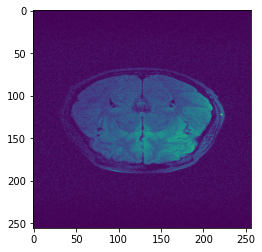

Time taken for epoch:  2.9900710582733154
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

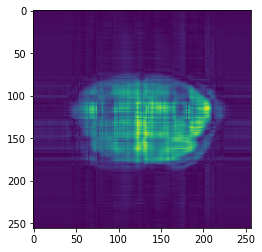

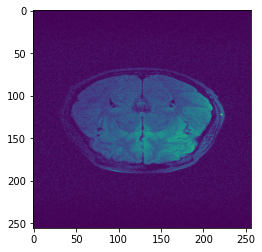

Time taken for epoch:  3.0960326194763184
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

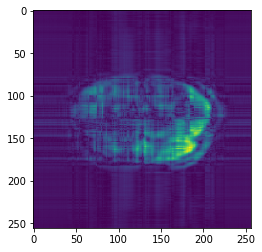

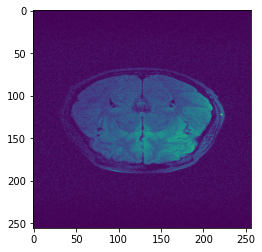

Time taken for epoch:  2.894613742828369
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

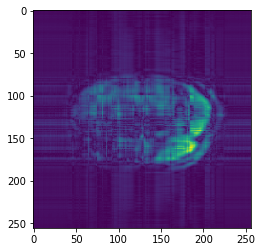

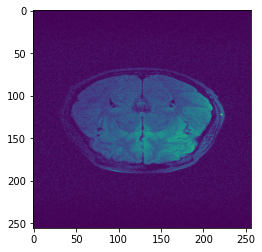

Time taken for epoch:  2.9511351585388184
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

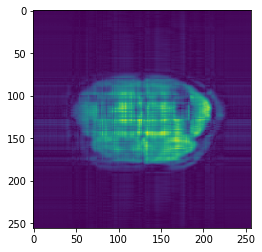

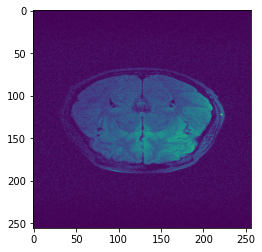

Time taken for epoch:  2.971848487854004
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

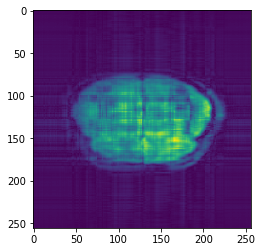

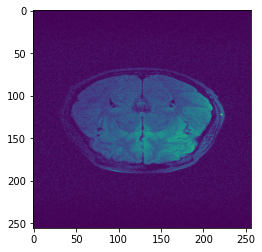

Time taken for epoch:  2.929190158843994
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

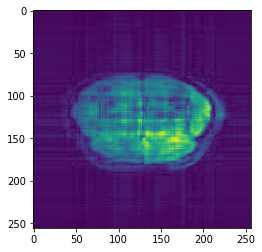

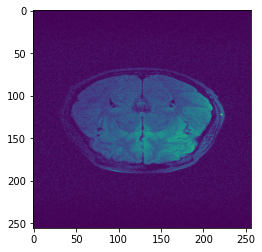

Time taken for epoch:  3.0253210067749023
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

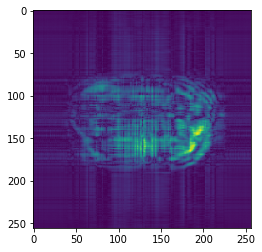

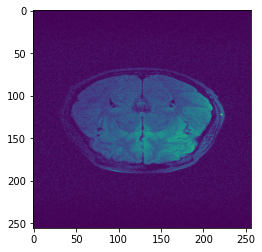

Time taken for epoch:  2.998816967010498
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

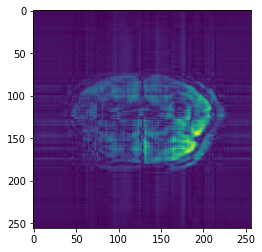

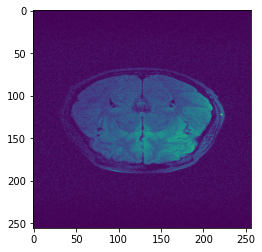

Time taken for epoch:  3.020672559738159
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

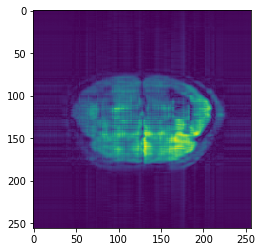

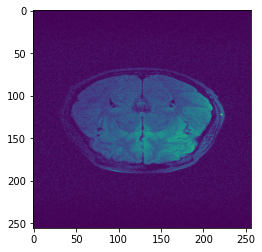

Time taken for epoch:  2.800846576690674
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

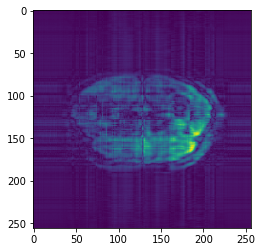

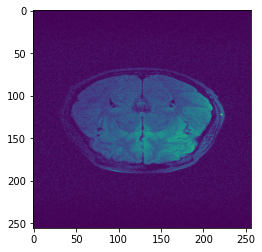

Time taken for epoch:  2.9416987895965576
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

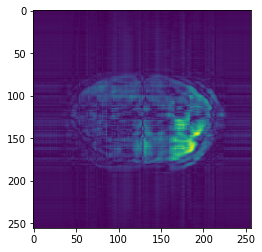

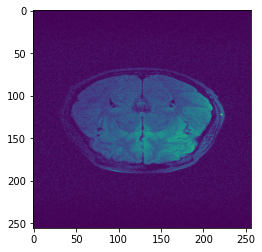

Time taken for epoch:  2.930121898651123
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out to

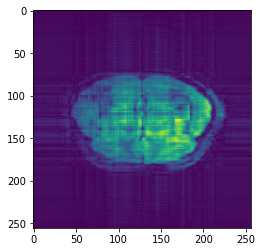

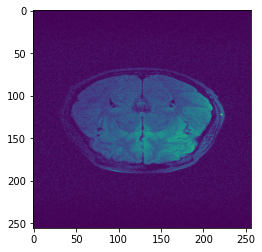

Time taken for epoch:  2.968986988067627
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

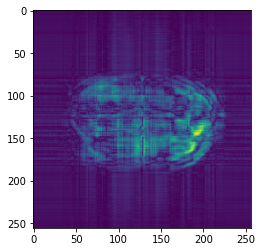

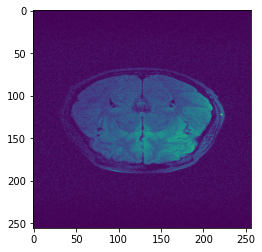

Time taken for epoch:  2.7962429523468018
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout to

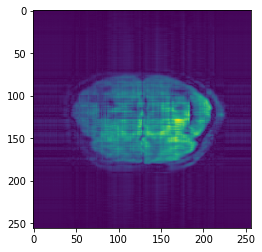

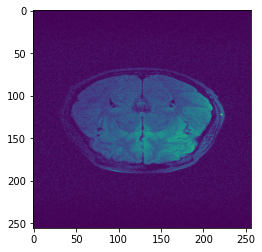

Time taken for epoch:  3.0085835456848145
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

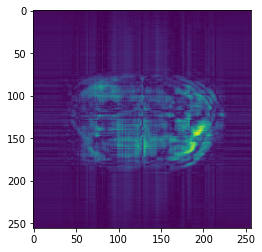

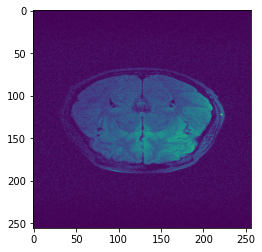

Time taken for epoch:  2.902803897857666
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

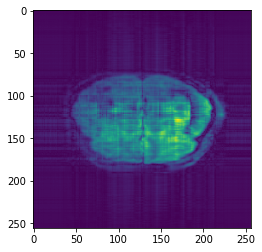

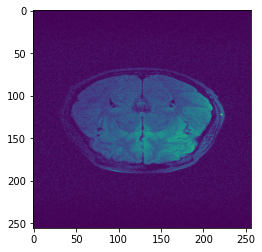

Time taken for epoch:  2.859973669052124
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

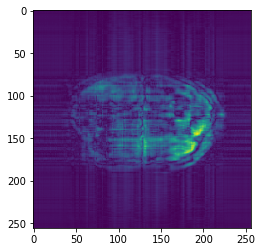

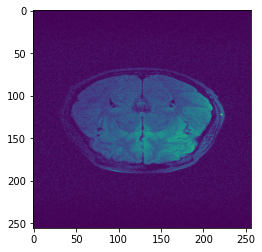

Time taken for epoch:  3.1089870929718018
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

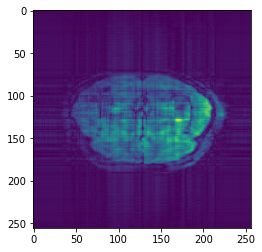

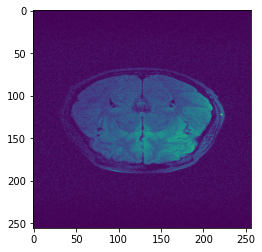

Time taken for epoch:  3.0967979431152344
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

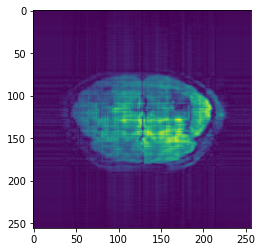

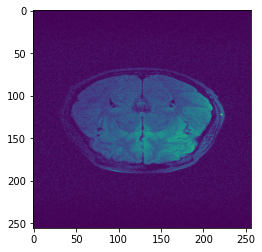

Time taken for epoch:  3.0358355045318604
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

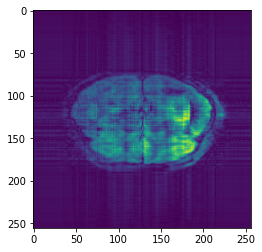

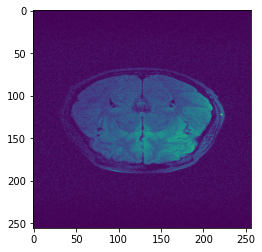

Time taken for epoch:  3.1405012607574463
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

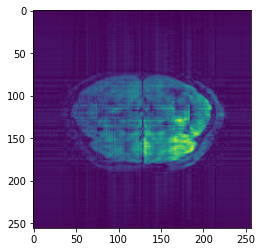

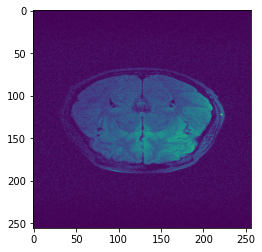

Time taken for epoch:  3.2103874683380127
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

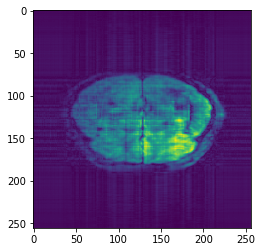

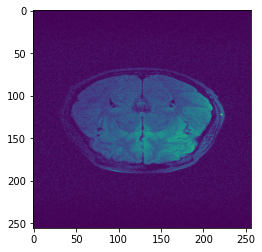

Time taken for epoch:  3.052630662918091
in torch.Size([8, 1, 256, 256])
outin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

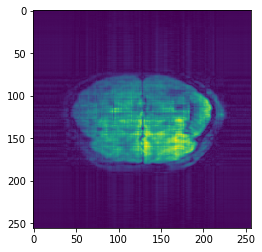

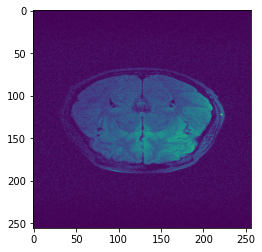

Time taken for epoch:  3.1056554317474365
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

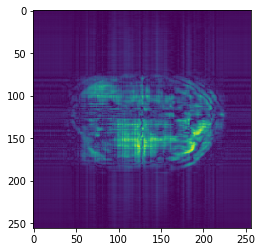

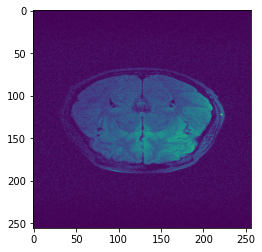

Time taken for epoch:  3.2351489067077637
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 intorch.Size([8, 256, 256]) 
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

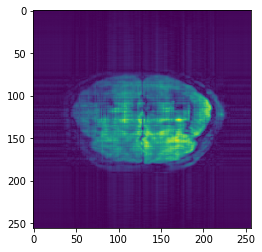

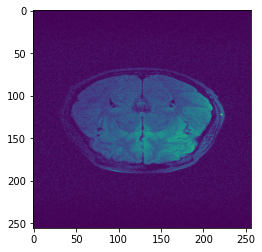

Time taken for epoch:  2.9531095027923584
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

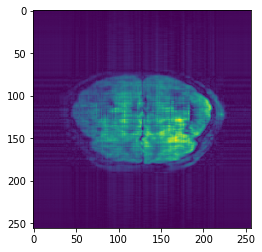

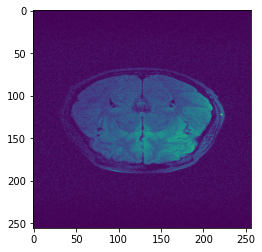

Time taken for epoch:  3.1666126251220703
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

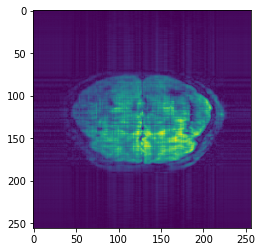

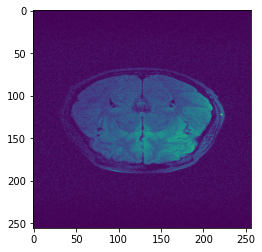

Time taken for epoch:  3.2521471977233887
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

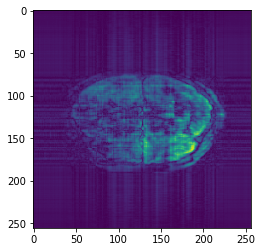

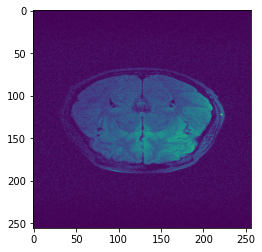

Time taken for epoch:  3.1115400791168213
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2out  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

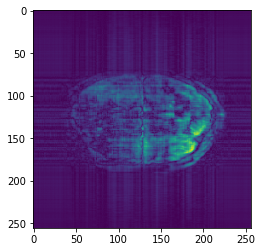

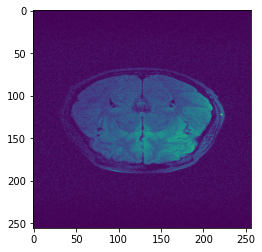

Time taken for epoch:  2.908064603805542
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

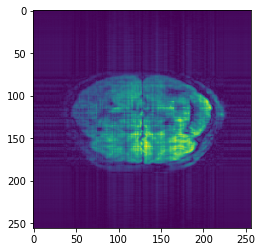

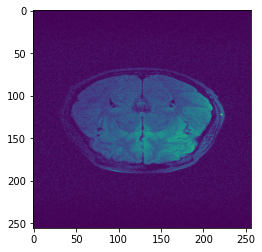

Time taken for epoch:  2.976886034011841
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

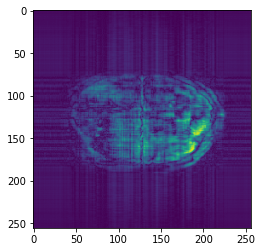

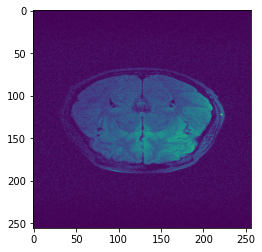

Time taken for epoch:  3.0023019313812256
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

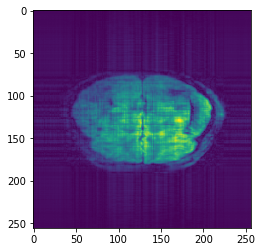

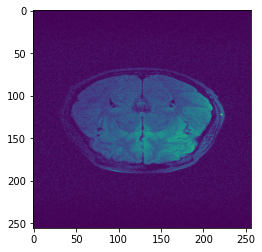

Time taken for epoch:  3.243318796157837
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])out
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])out2
 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

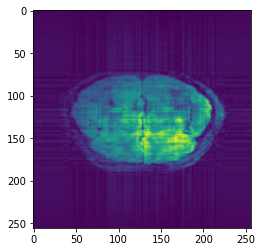

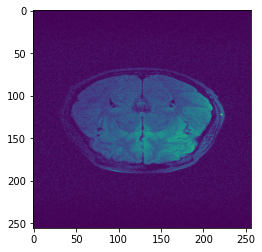

Time taken for epoch:  2.9935784339904785
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

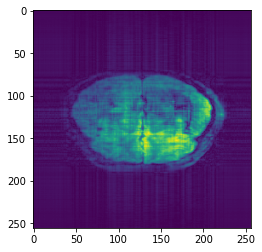

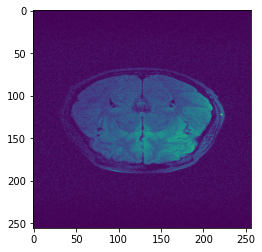

Time taken for epoch:  2.9013161659240723
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

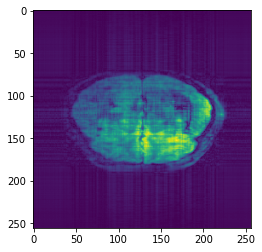

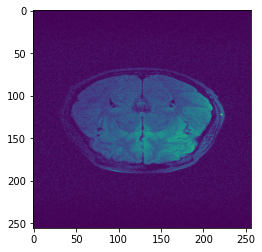

Time taken for epoch:  3.1380538940429688
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

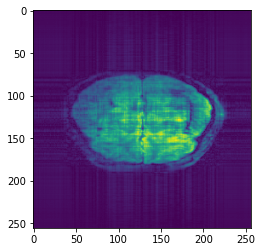

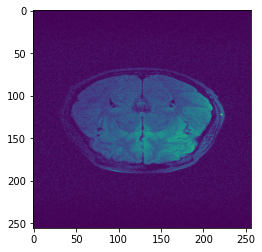

Time taken for epoch:  2.8909249305725098
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 1, 256, 256])torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

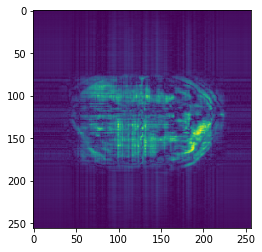

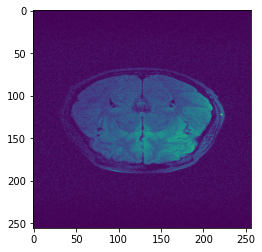

Time taken for epoch:  2.9964468479156494
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

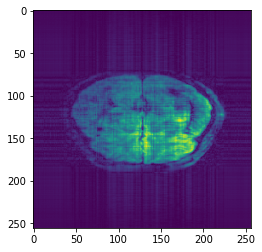

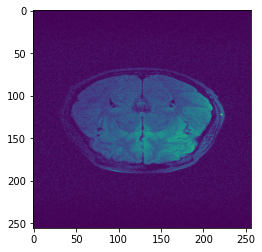

Time taken for epoch:  3.199047565460205
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
outout torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

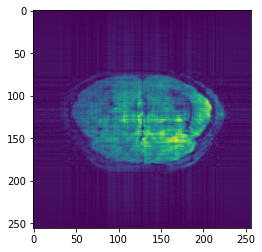

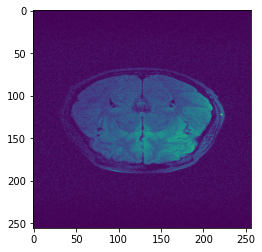

Time taken for epoch:  2.9581334590911865
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

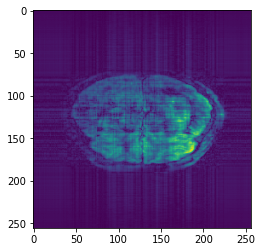

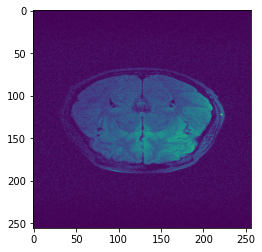

Time taken for epoch:  3.1161487102508545
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

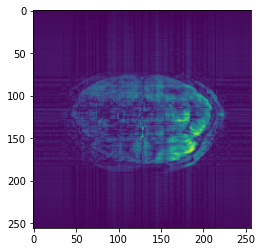

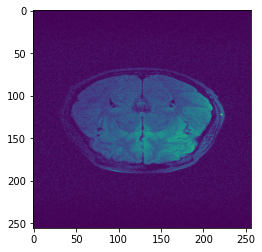

Time taken for epoch:  3.2256364822387695
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

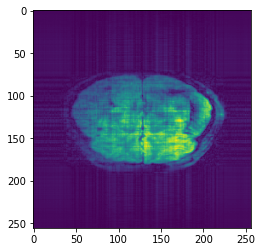

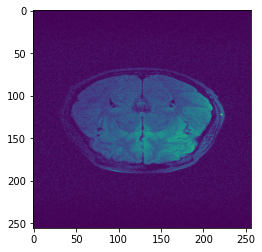

Time taken for epoch:  2.93861722946167
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

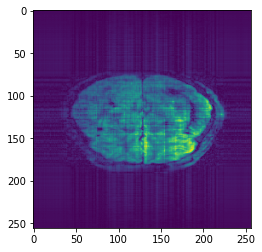

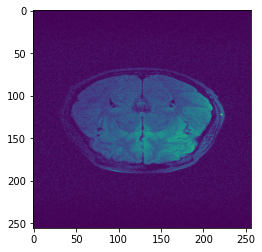

Time taken for epoch:  3.0960614681243896
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

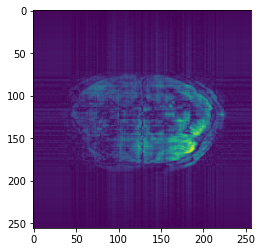

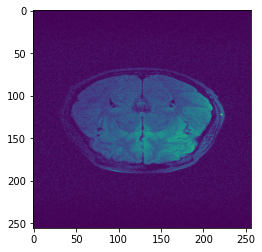

Time taken for epoch:  2.8535985946655273
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

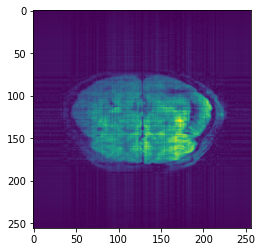

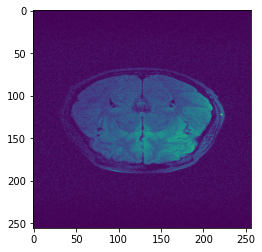

Time taken for epoch:  3.177419424057007
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

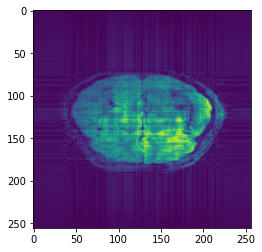

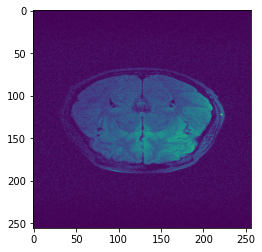

Time taken for epoch:  3.2413008213043213
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

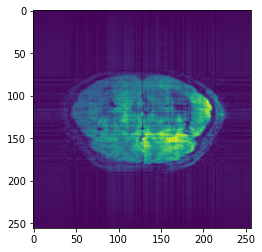

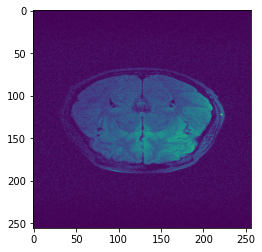

Time taken for epoch:  3.124704122543335
in intorch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

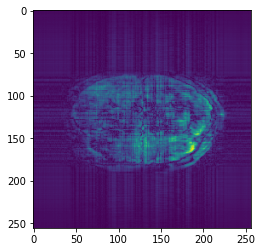

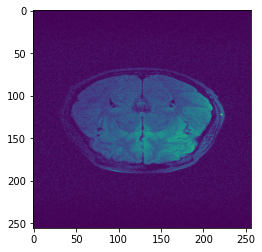

Time taken for epoch:  3.002892017364502
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

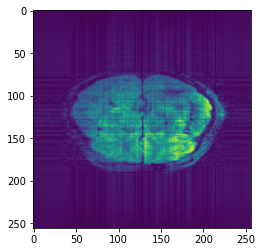

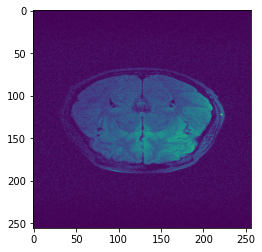

Time taken for epoch:  2.908173084259033
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

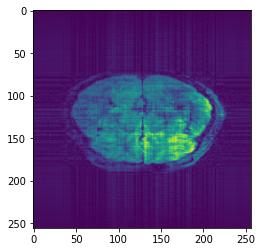

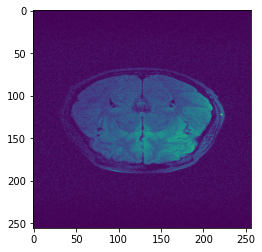

Time taken for epoch:  2.8998525142669678
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

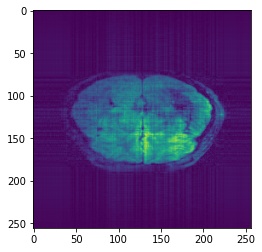

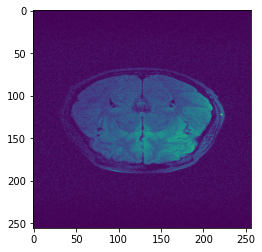

Time taken for epoch:  3.055009126663208
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

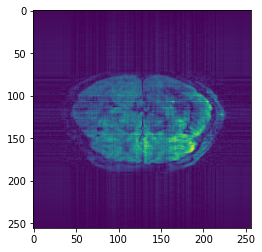

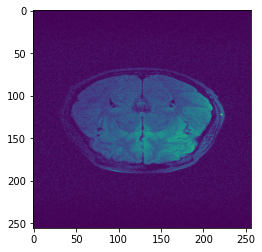

Time taken for epoch:  2.9681129455566406
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

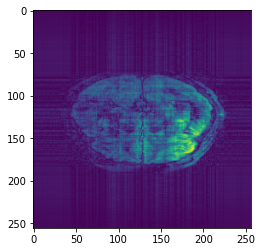

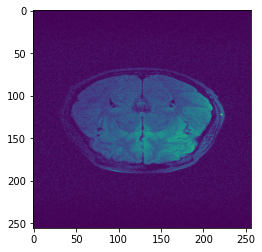

Time taken for epoch:  2.9671781063079834
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

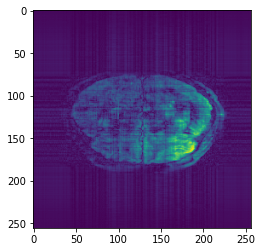

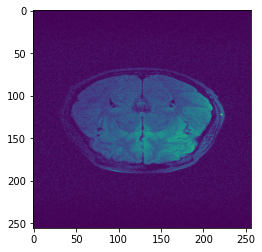

Time taken for epoch:  2.9493634700775146
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

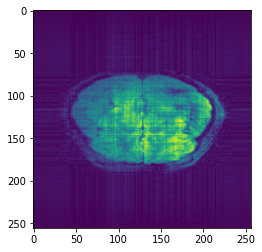

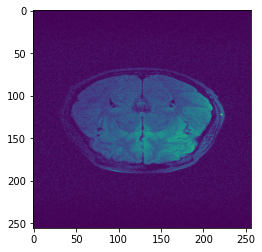

Time taken for epoch:  2.9086740016937256
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2out torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

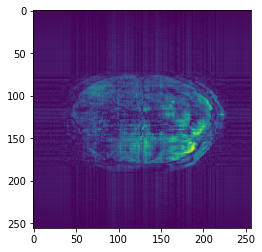

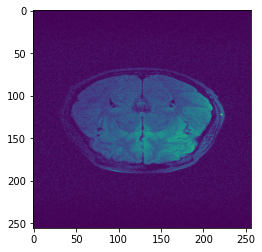

Time taken for epoch:  3.1850192546844482
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

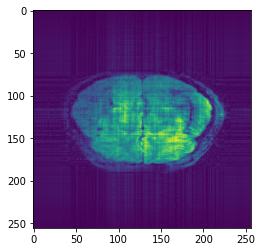

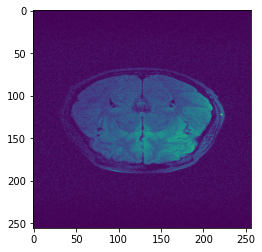

Time taken for epoch:  2.980318069458008
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

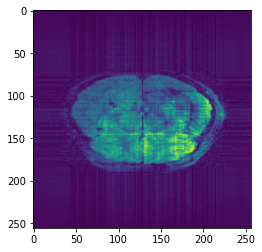

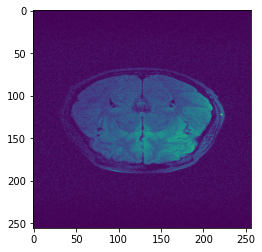

Time taken for epoch:  2.8275146484375
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
i

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

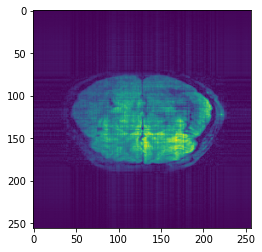

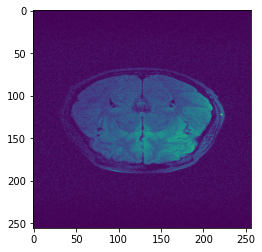

Time taken for epoch:  3.078359842300415
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])out
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out to

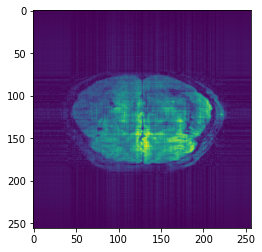

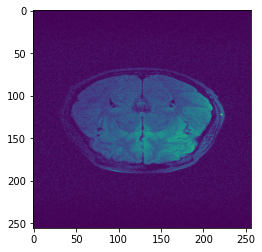

Time taken for epoch:  2.910393714904785
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

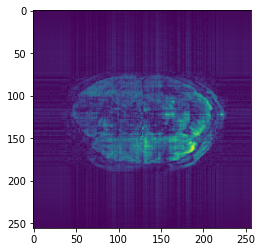

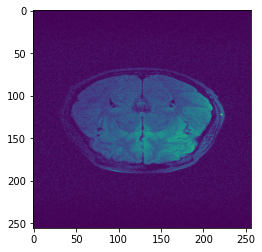

Time taken for epoch:  3.051485538482666
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out to

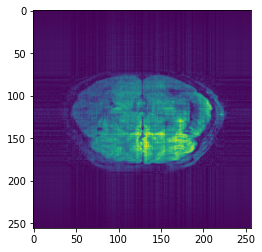

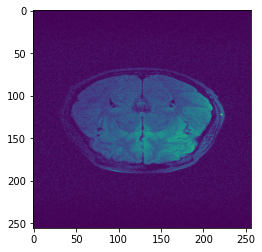

Time taken for epoch:  2.9149839878082275
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

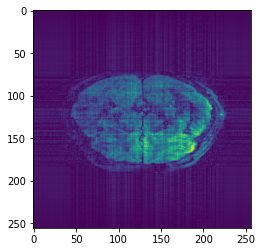

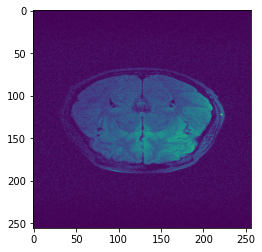

Time taken for epoch:  3.1188318729400635
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

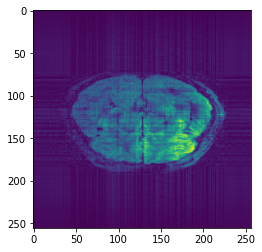

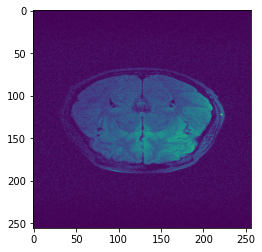

Time taken for epoch:  3.1970434188842773
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

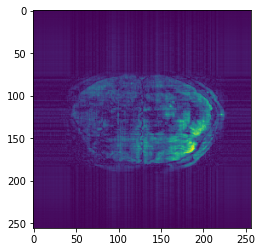

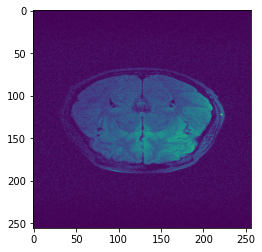

Time taken for epoch:  3.0411376953125
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])in
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
i

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

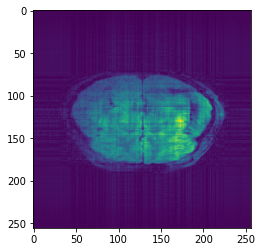

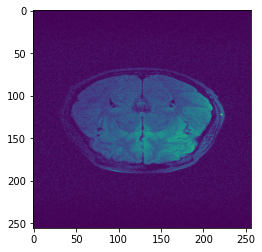

Time taken for epoch:  2.9910550117492676
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

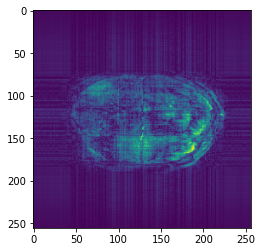

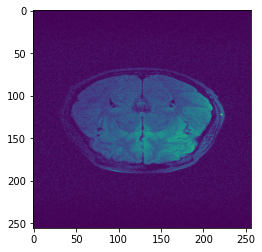

Time taken for epoch:  3.136308193206787
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

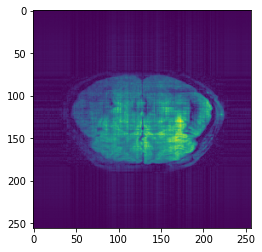

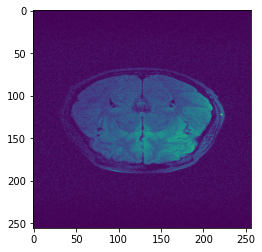

Time taken for epoch:  3.088298797607422
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 intorch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

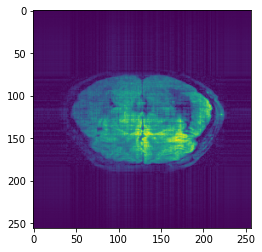

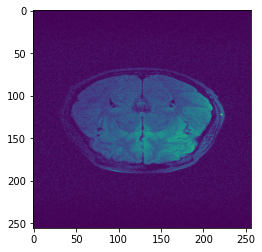

Time taken for epoch:  3.1494762897491455
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])in
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

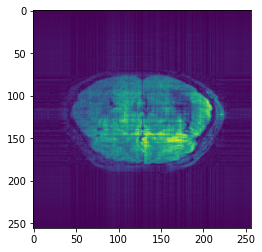

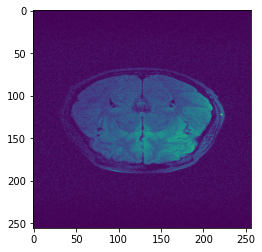

Time taken for epoch:  3.0921926498413086
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

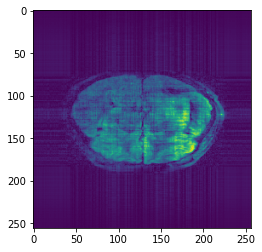

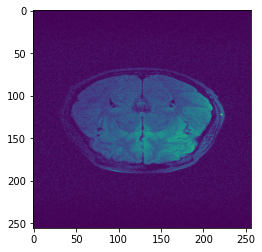

Time taken for epoch:  2.886017084121704
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

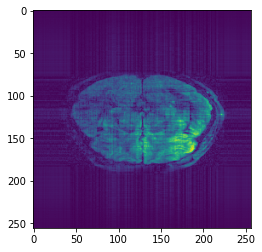

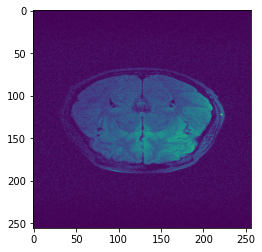

Time taken for epoch:  2.8988687992095947
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])in torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

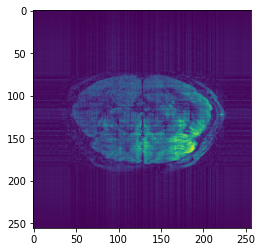

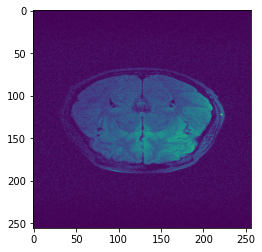

Time taken for epoch:  2.8779456615448
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
i

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

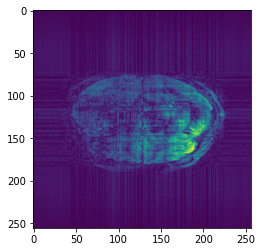

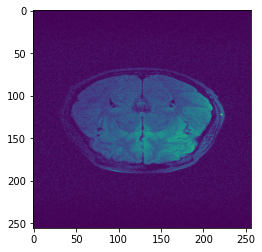

Time taken for epoch:  3.1876463890075684
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

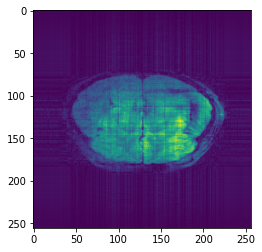

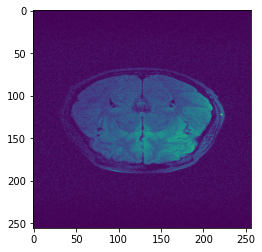

Time taken for epoch:  3.129309892654419
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

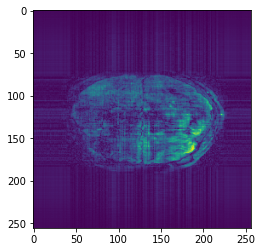

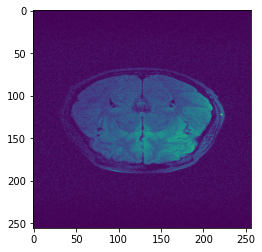

Time taken for epoch:  2.802730083465576
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

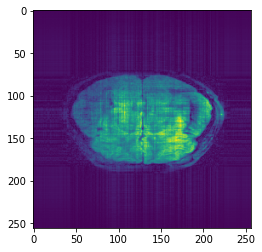

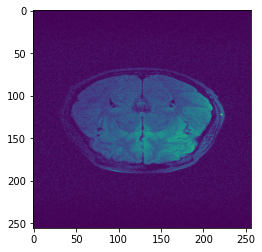

Time taken for epoch:  3.123054265975952
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 out2torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

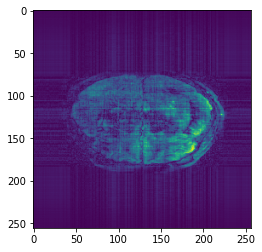

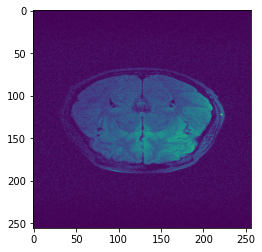

Time taken for epoch:  2.9544525146484375
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out2  torch.Size([8, 256, 256])
torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out to

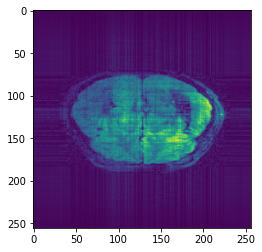

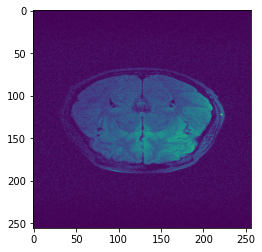

Time taken for epoch:  3.125436544418335
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2out torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

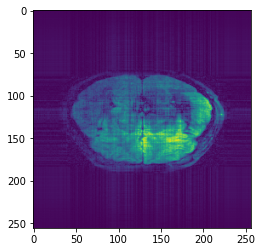

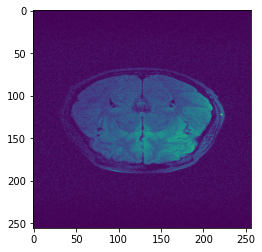

Time taken for epoch:  2.9878506660461426
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

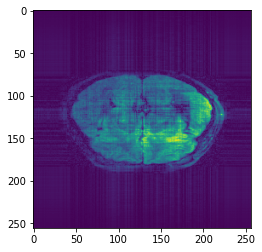

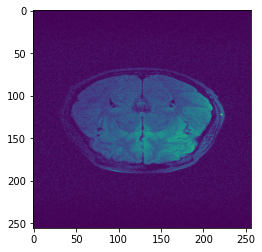

Time taken for epoch:  2.9126858711242676
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

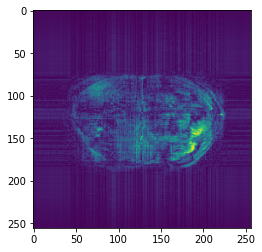

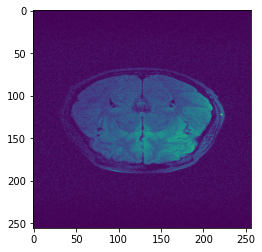

Time taken for epoch:  2.9769797325134277
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

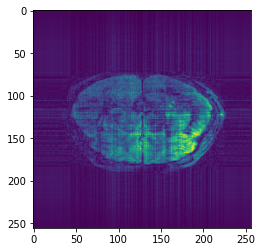

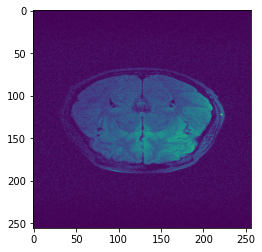

Time taken for epoch:  3.0350341796875
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
i

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

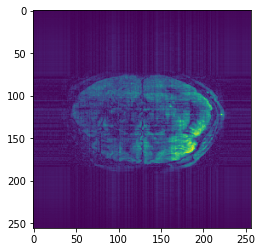

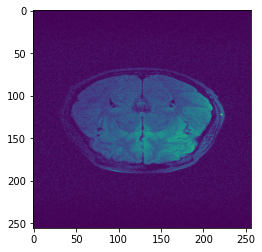

Time taken for epoch:  2.9933454990386963
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out  torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

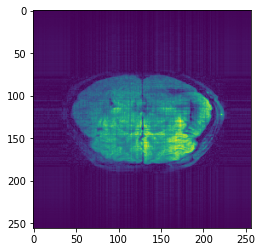

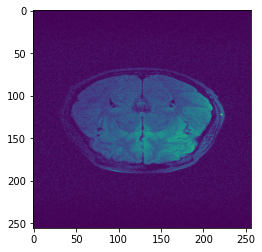

Time taken for epoch:  2.9470324516296387
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

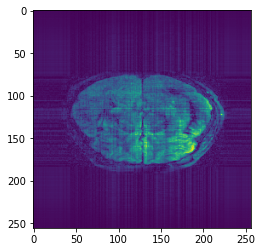

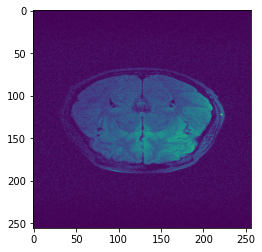

Time taken for epoch:  3.0999319553375244
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torc

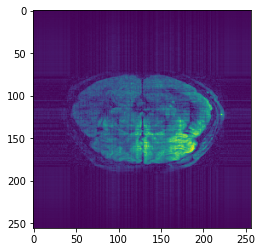

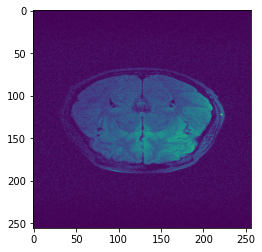

Time taken for epoch:  3.0265650749206543
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

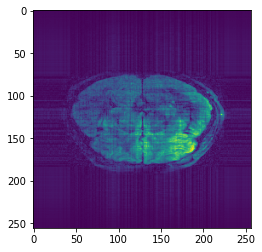

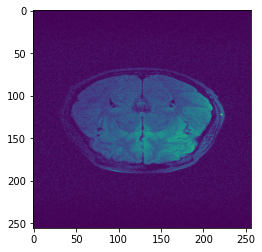

Time taken for epoch:  2.906069755554199
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

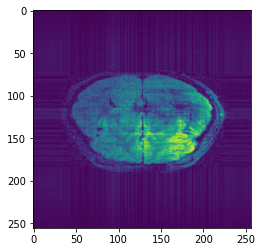

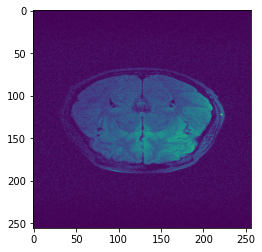

Time taken for epoch:  2.9441771507263184
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

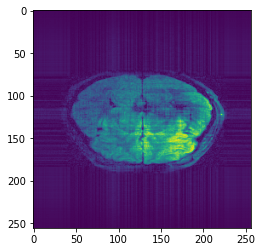

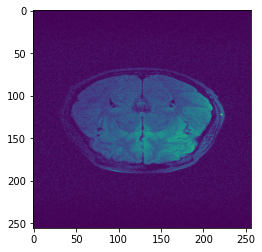

Time taken for epoch:  3.2489216327667236
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

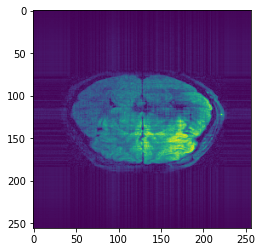

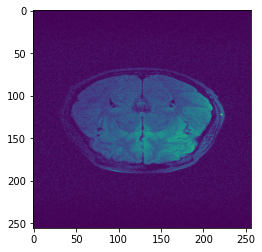

Time taken for epoch:  2.9809751510620117
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

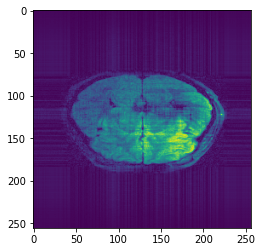

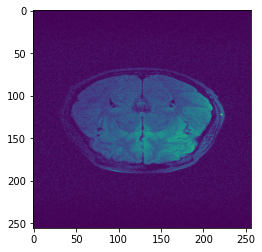

Time taken for epoch:  3.137188673019409
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

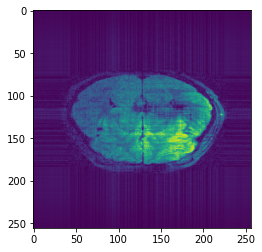

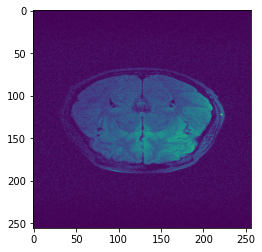

Time taken for epoch:  2.9192824363708496
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

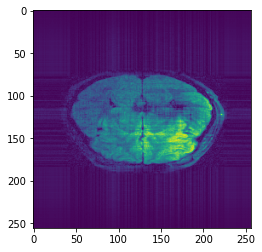

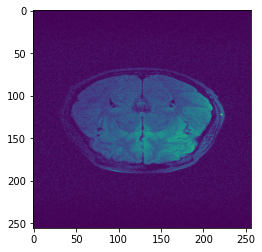

Time taken for epoch:  3.0648438930511475
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

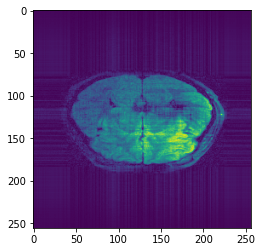

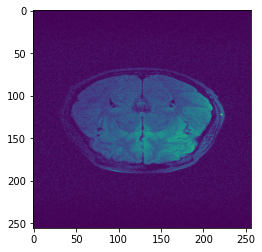

Time taken for epoch:  2.95206880569458
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

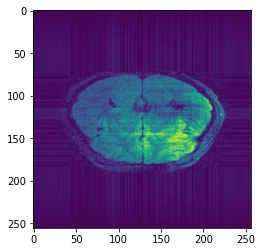

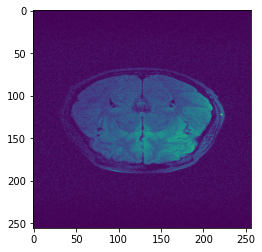

Time taken for epoch:  3.0670487880706787
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

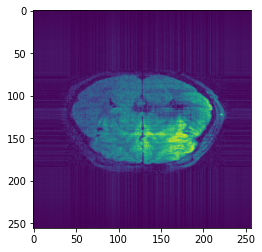

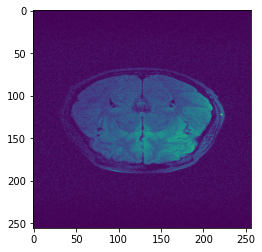

Time taken for epoch:  2.9425606727600098
inin  torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

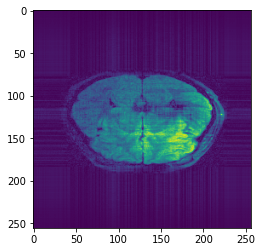

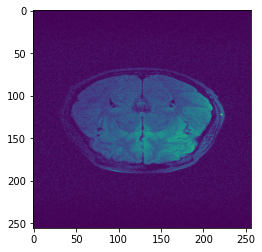

Time taken for epoch:  3.1516451835632324
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

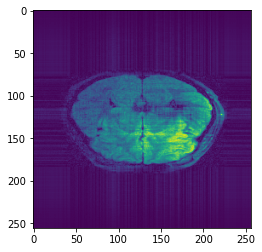

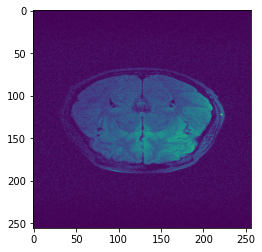

Time taken for epoch:  3.227531909942627
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

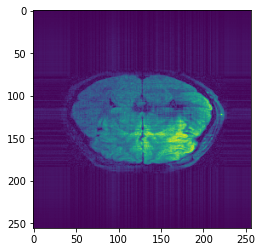

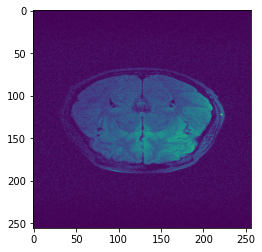

Time taken for epoch:  3.0276060104370117
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
outin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

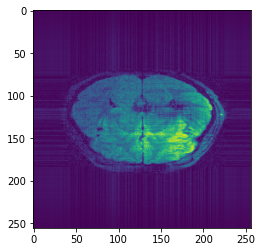

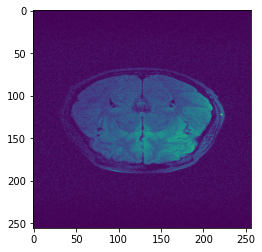

Time taken for epoch:  2.8852813243865967
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])in torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

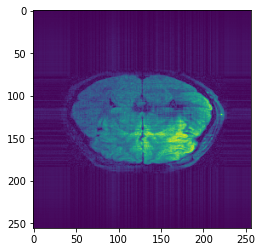

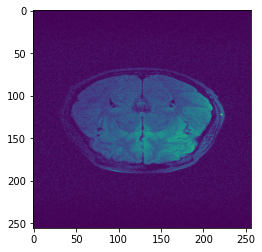

Time taken for epoch:  2.9638540744781494
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

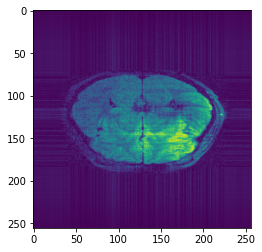

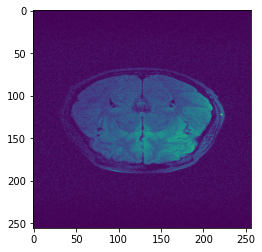

Time taken for epoch:  3.0002291202545166
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

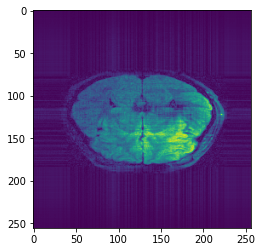

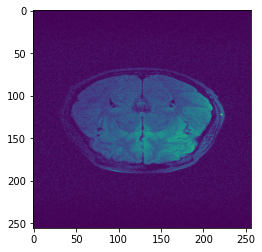

Time taken for epoch:  2.8083224296569824
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

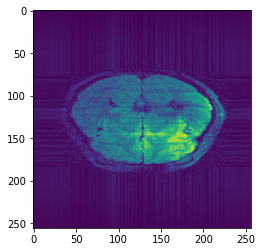

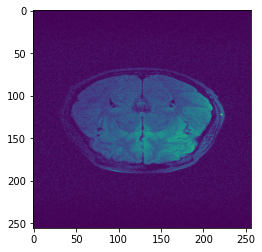

Time taken for epoch:  3.054014205932617
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

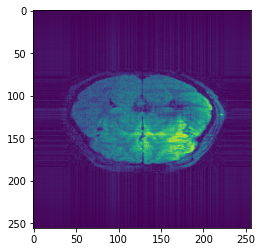

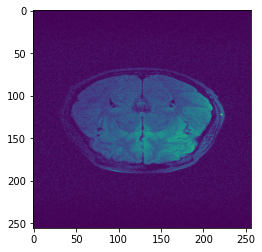

Time taken for epoch:  2.8853647708892822
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

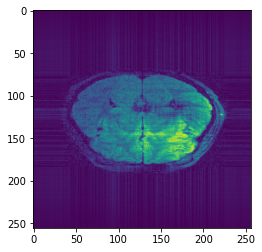

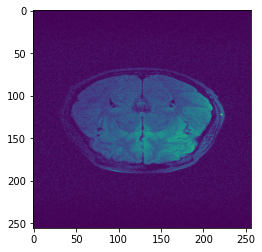

Time taken for epoch:  3.124830722808838
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

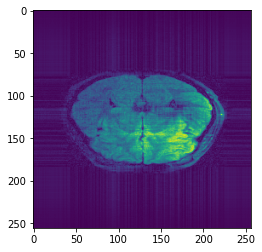

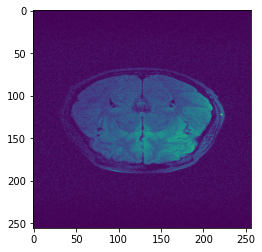

Time taken for epoch:  2.7993531227111816
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

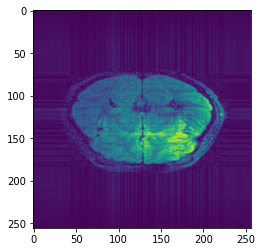

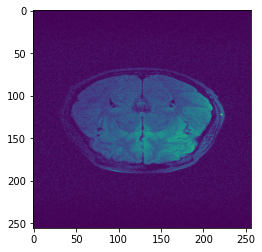

Time taken for epoch:  2.89080810546875
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
outout torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

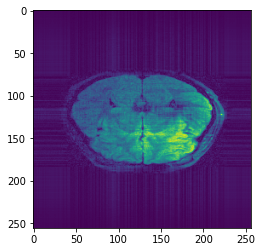

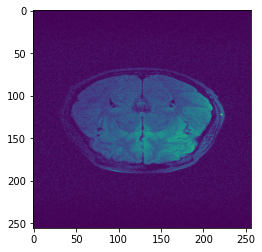

Time taken for epoch:  2.9962449073791504
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

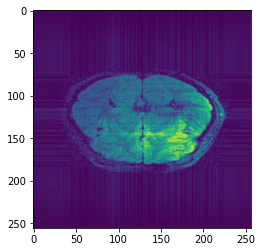

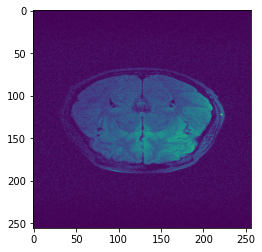

Time taken for epoch:  2.8422205448150635
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

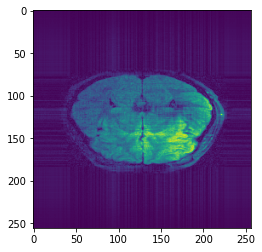

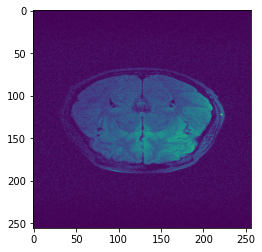

Time taken for epoch:  2.9163475036621094
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

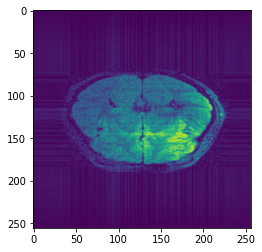

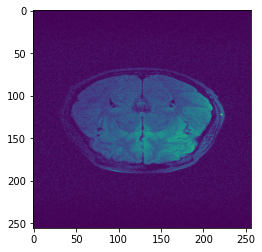

Time taken for epoch:  3.0317776203155518
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

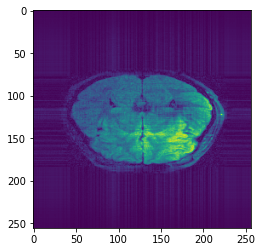

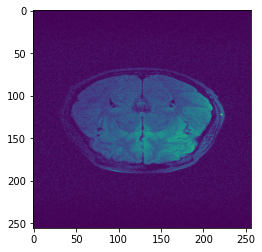

Time taken for epoch:  2.8903682231903076
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in outtorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

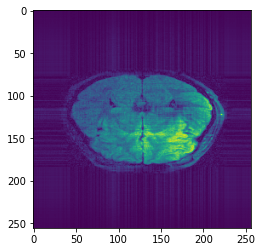

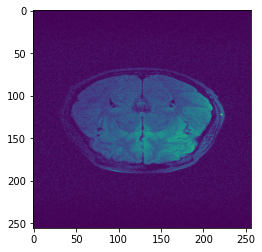

Time taken for epoch:  3.049867630004883
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out2 torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

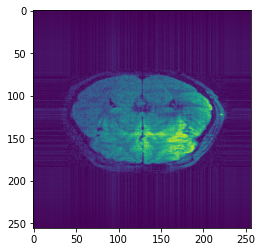

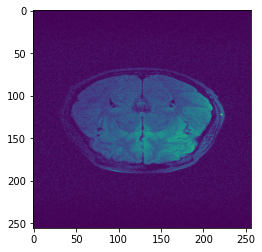

Time taken for epoch:  3.1264657974243164
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

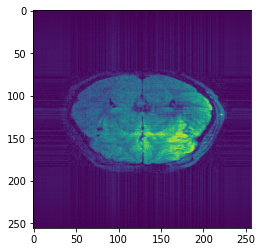

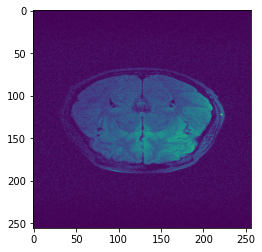

Time taken for epoch:  2.923086166381836
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])

out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

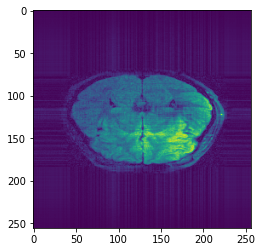

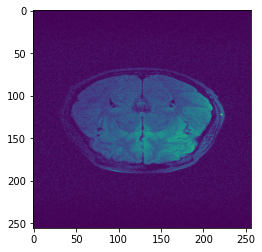

Time taken for epoch:  2.9173712730407715
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

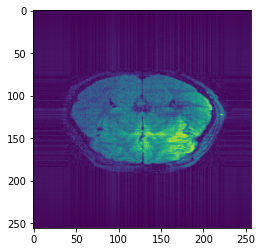

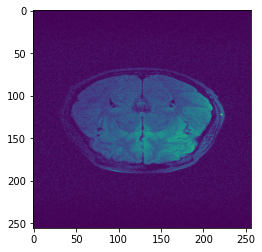

Time taken for epoch:  2.9427638053894043
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

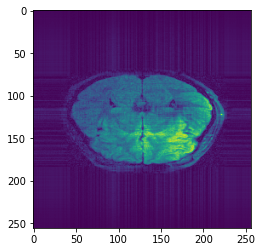

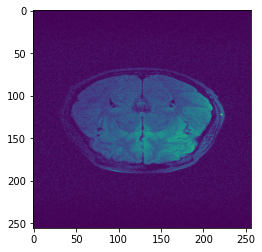

Time taken for epoch:  3.0706043243408203
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

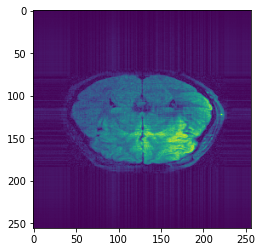

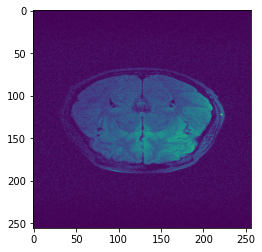

Time taken for epoch:  2.9169883728027344
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out to

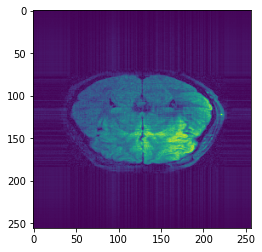

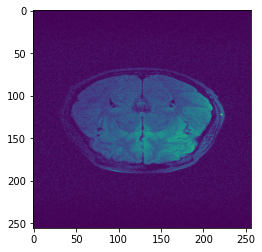

Time taken for epoch:  2.9475321769714355
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in outtorch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

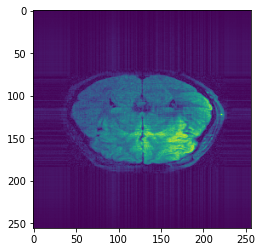

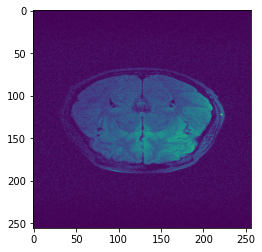

Time taken for epoch:  3.085608959197998
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

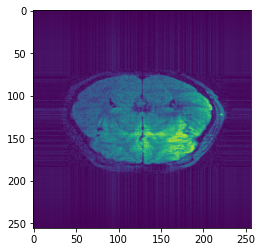

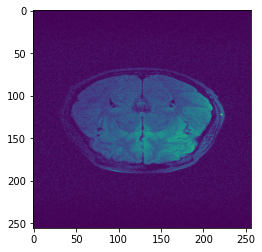

Time taken for epoch:  2.9392905235290527
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

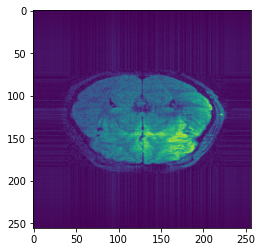

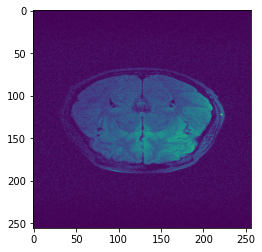

Time taken for epoch:  3.12069034576416
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])out2
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

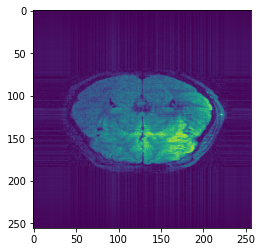

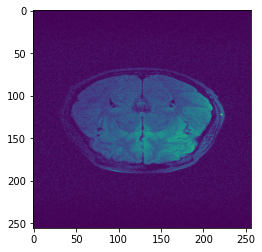

Time taken for epoch:  3.384356737136841
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

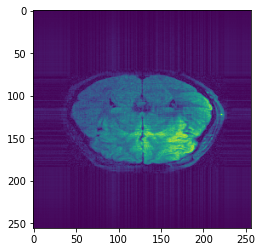

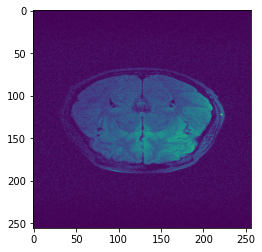

Time taken for epoch:  2.8922903537750244
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out2 torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

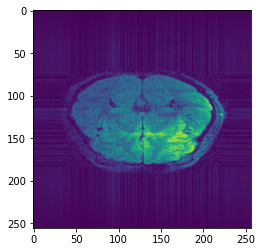

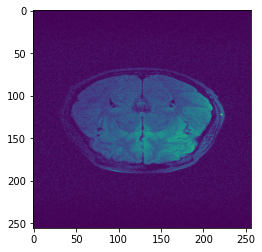

Time taken for epoch:  3.039369583129883
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

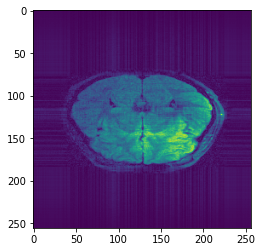

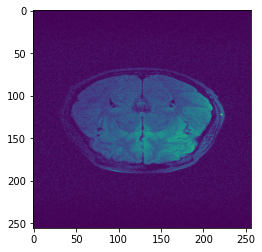

Time taken for epoch:  2.966613292694092
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

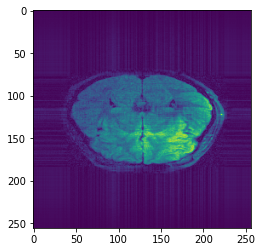

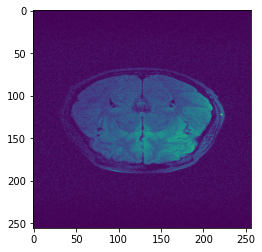

Time taken for epoch:  2.847111940383911
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

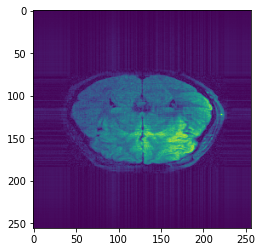

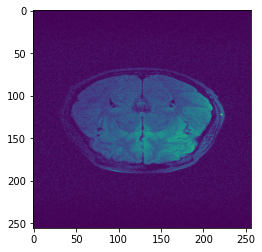

Time taken for epoch:  2.889347791671753
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
outout torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

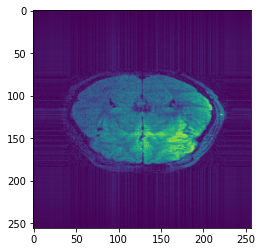

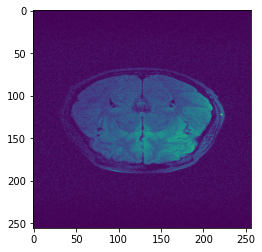

Time taken for epoch:  3.594883441925049
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

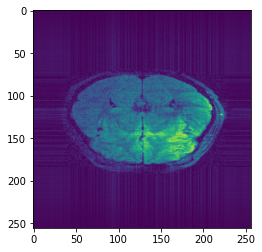

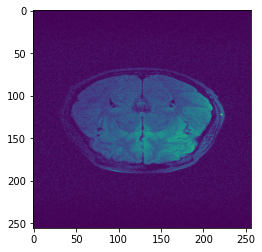

Time taken for epoch:  3.2031185626983643
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

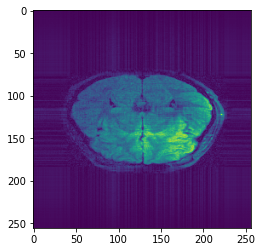

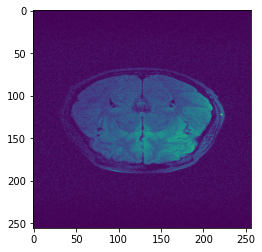

Time taken for epoch:  2.9559850692749023
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

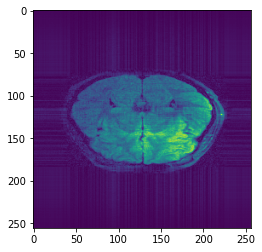

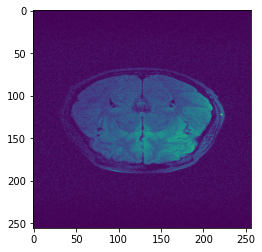

Time taken for epoch:  2.871192455291748
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

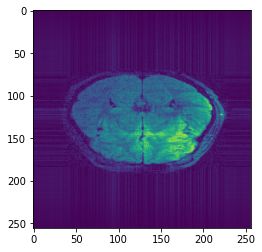

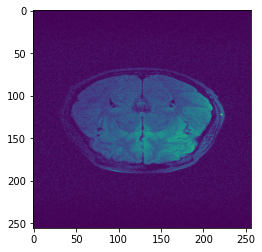

Time taken for epoch:  2.841242790222168
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

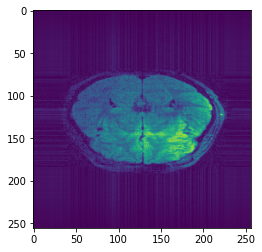

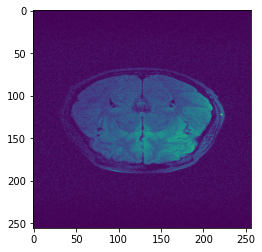

Time taken for epoch:  3.00518536567688
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch

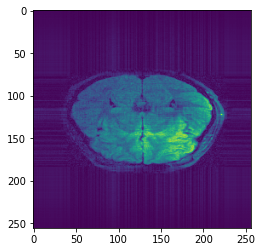

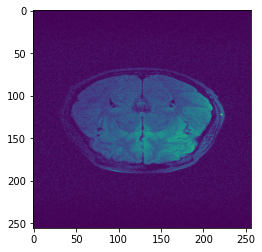

Time taken for epoch:  3.197838306427002
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

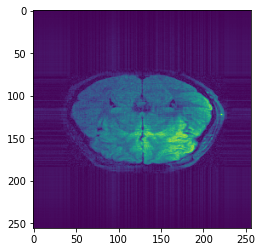

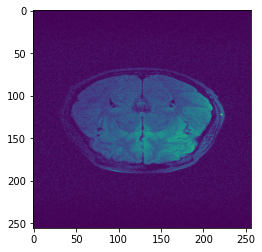

Time taken for epoch:  3.0131309032440186
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

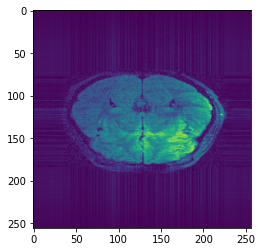

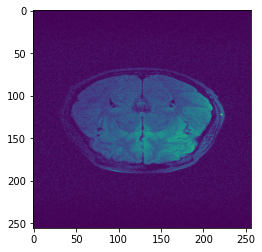

Time taken for epoch:  2.9568328857421875
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

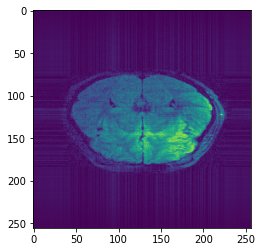

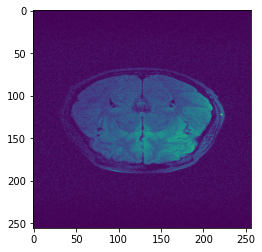

Time taken for epoch:  3.093094825744629
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])

out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

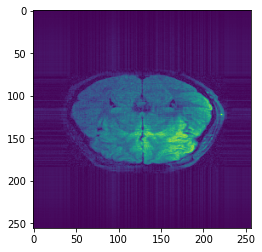

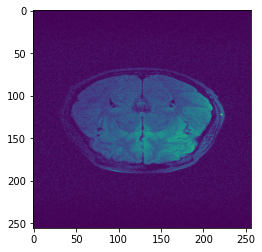

Time taken for epoch:  3.1374499797821045
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

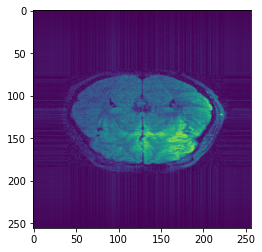

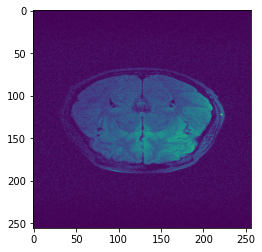

Time taken for epoch:  3.0791914463043213
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

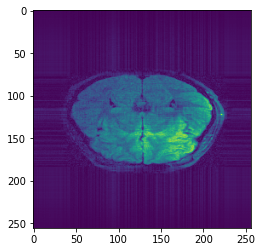

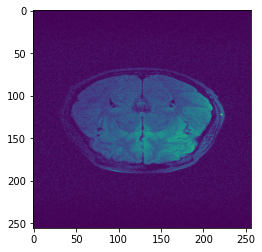

Time taken for epoch:  2.8774466514587402
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out t

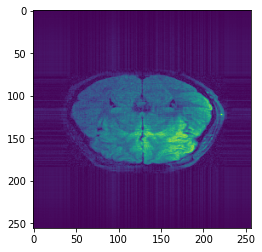

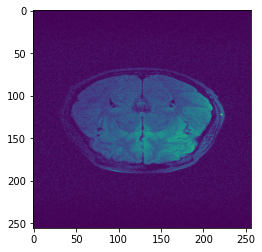

Time taken for epoch:  3.0392849445343018
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

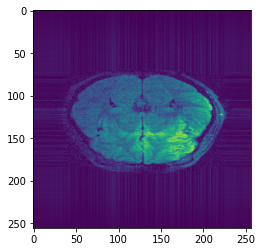

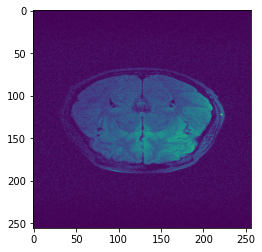

Time taken for epoch:  2.8231492042541504
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

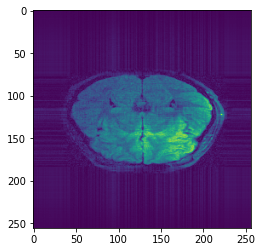

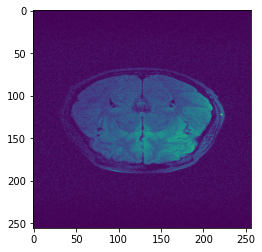

Time taken for epoch:  2.940263032913208
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

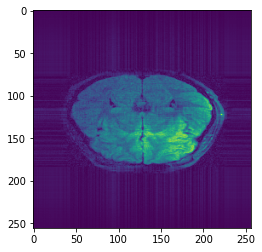

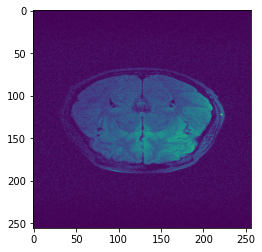

Time taken for epoch:  2.926485300064087
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

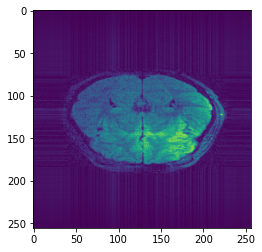

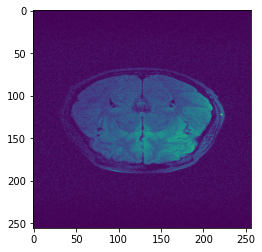

Time taken for epoch:  3.008185863494873
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

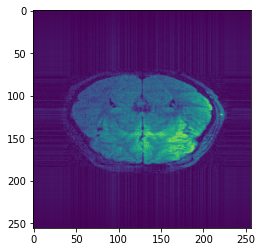

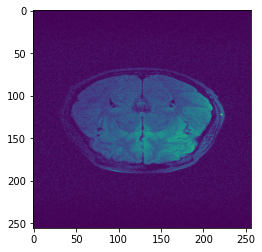

Time taken for epoch:  2.8831324577331543
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

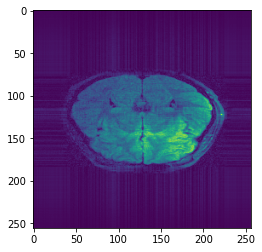

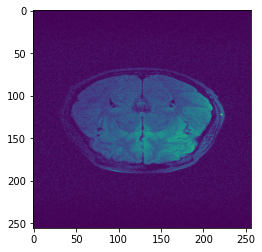

Time taken for epoch:  3.1946921348571777
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

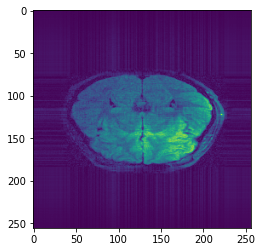

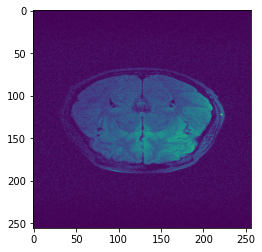

Time taken for epoch:  2.9863831996917725
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

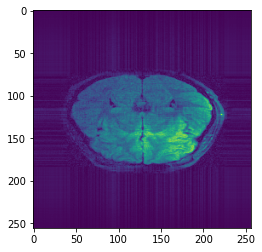

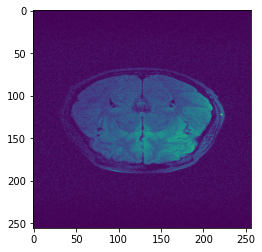

Time taken for epoch:  3.2121808528900146
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

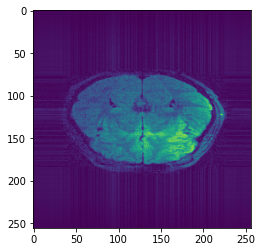

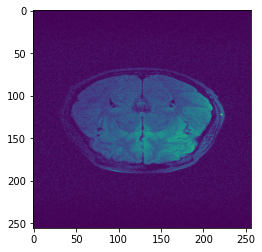

Time taken for epoch:  3.163756847381592
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2  torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out out2torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

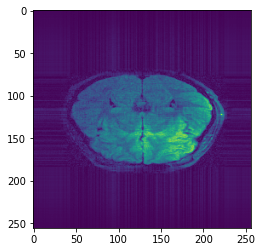

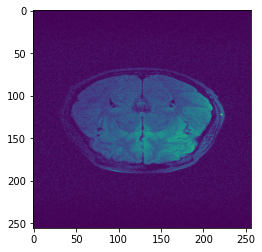

Time taken for epoch:  2.8922548294067383
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

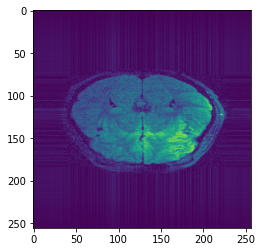

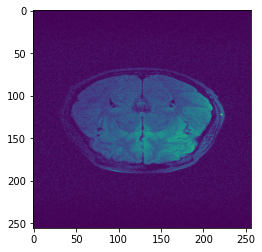

Time taken for epoch:  3.1617298126220703
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 1, 256, 256])torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

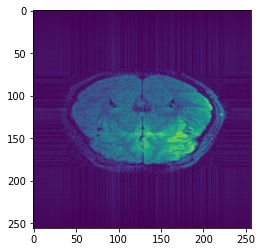

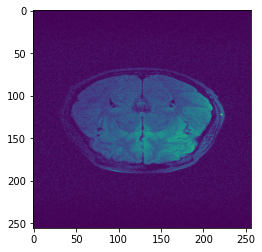

Time taken for epoch:  2.917673349380493
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out to

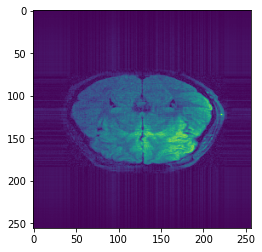

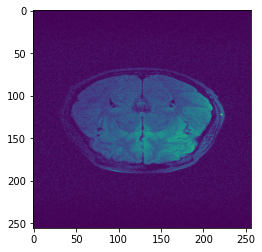

Time taken for epoch:  2.9423844814300537
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
outin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

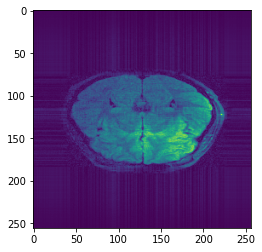

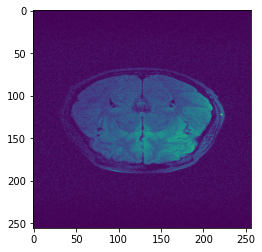

Time taken for epoch:  2.9587724208831787
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
outin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out2  torch.Size([8, 256, 256])
torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])out
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

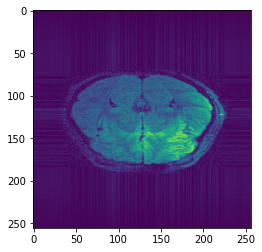

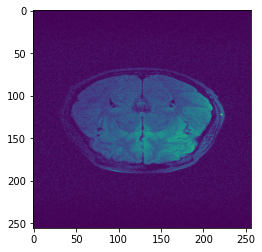

Time taken for epoch:  3.0144219398498535
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

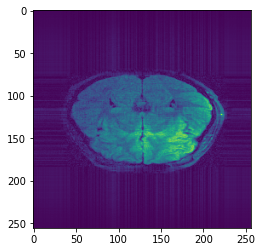

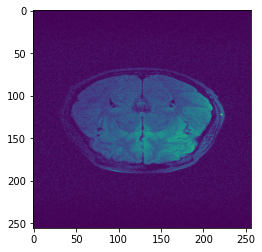

Time taken for epoch:  2.852403163909912
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

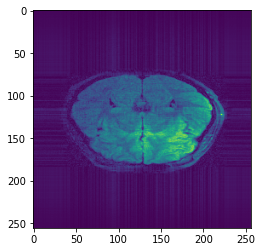

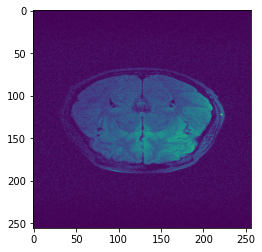

Time taken for epoch:  2.915485143661499
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])out
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

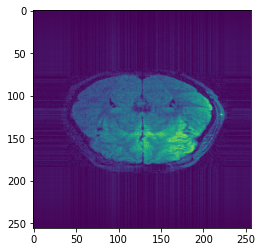

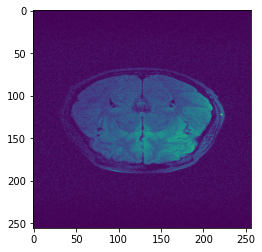

Time taken for epoch:  2.787260055541992
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

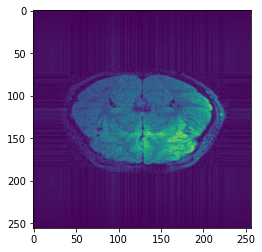

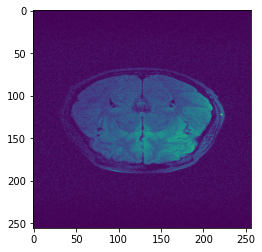

Time taken for epoch:  2.729964256286621
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
inout torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

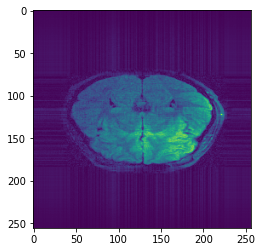

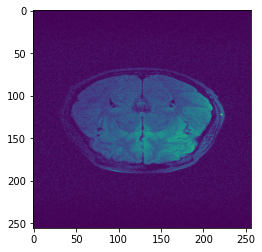

Time taken for epoch:  2.9371211528778076
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

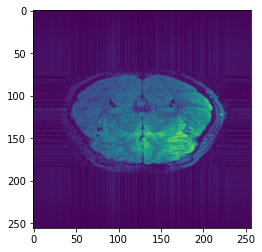

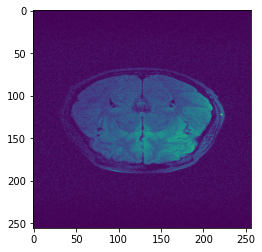

Time taken for epoch:  3.237706184387207
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])out torch.Size([8, 1, 256, 256])

out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

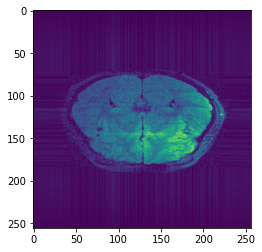

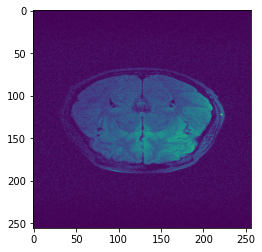

Time taken for epoch:  2.9381494522094727
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

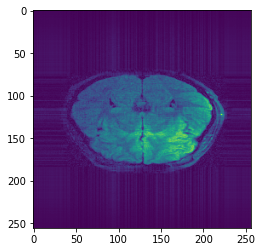

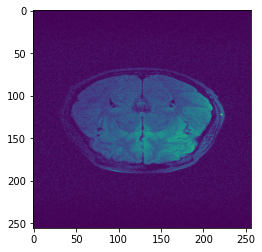

Time taken for epoch:  2.913606643676758
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])out2
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

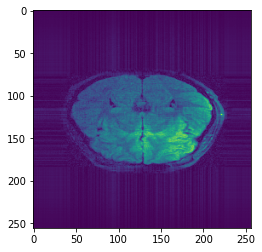

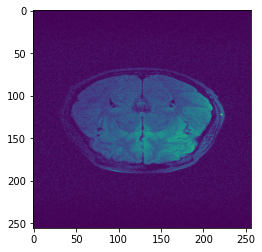

Time taken for epoch:  3.0938162803649902
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

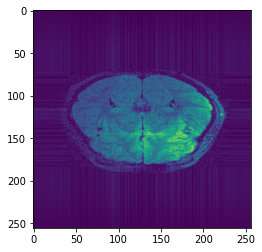

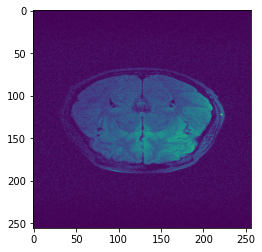

Time taken for epoch:  3.1516270637512207
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])in
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

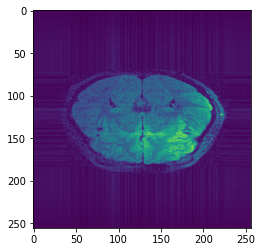

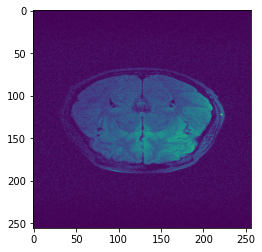

Time taken for epoch:  3.0011043548583984
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

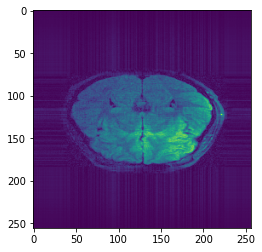

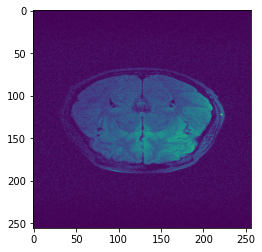

Time taken for epoch:  3.0630533695220947
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2out torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

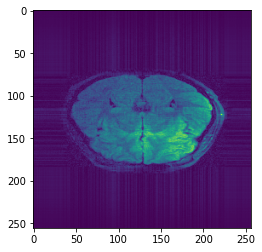

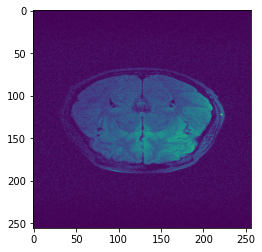

Time taken for epoch:  2.9588611125946045
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

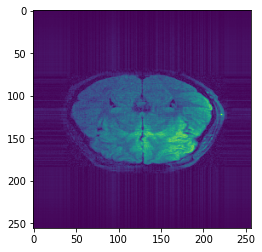

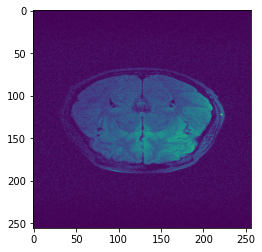

Time taken for epoch:  2.905608654022217
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

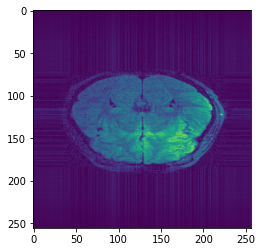

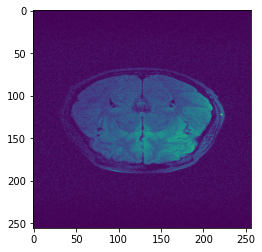

Time taken for epoch:  3.0921547412872314
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

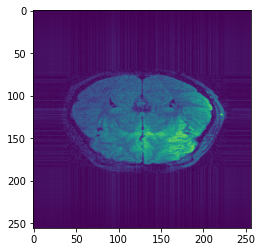

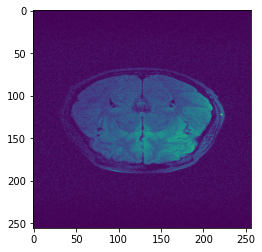

Time taken for epoch:  2.9713943004608154
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

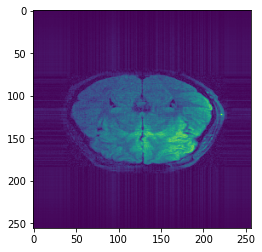

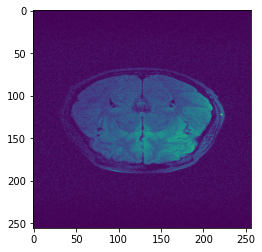

Time taken for epoch:  2.9002902507781982
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
outout torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

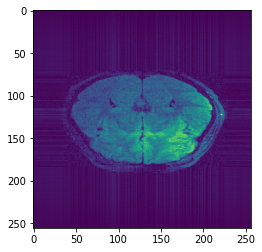

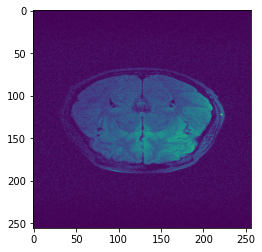

Time taken for epoch:  2.898897647857666
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

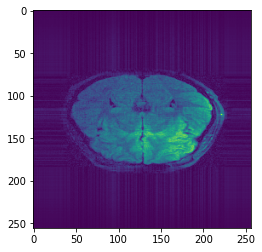

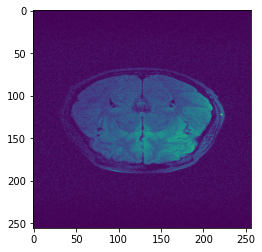

Time taken for epoch:  3.2333791255950928
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

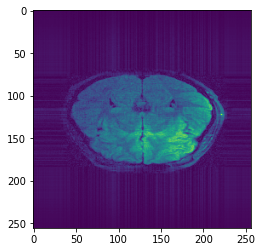

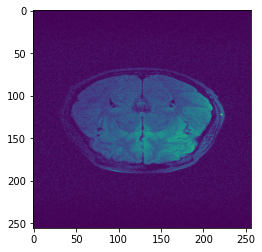

Time taken for epoch:  2.904711961746216
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 1, 256, 256])torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

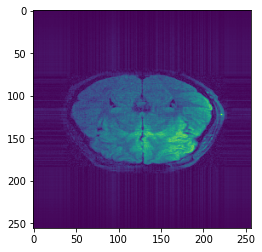

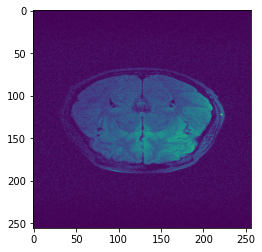

Time taken for epoch:  2.894089460372925
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
outout torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

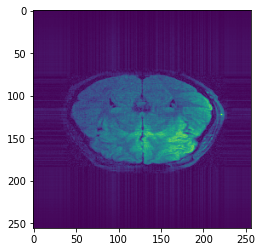

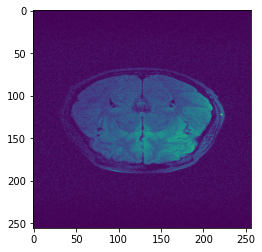

Time taken for epoch:  3.062020778656006
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in 
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

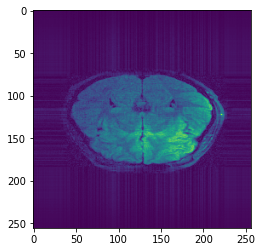

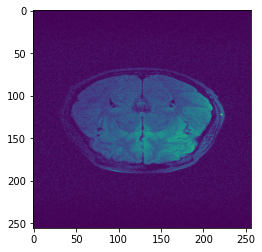

Time taken for epoch:  2.8322572708129883
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

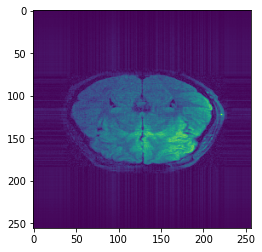

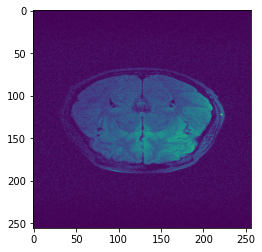

Time taken for epoch:  3.125868558883667
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 intorch.Size([8, 256, 256]) 
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out t

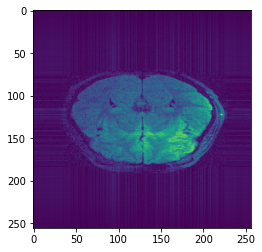

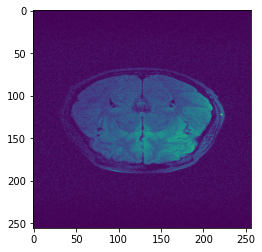

Time taken for epoch:  3.0490379333496094
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

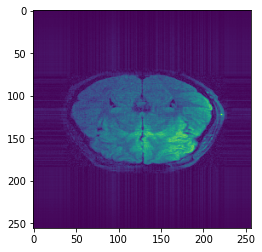

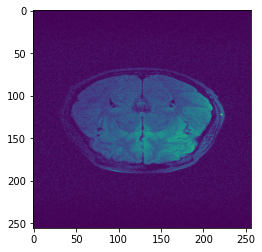

Time taken for epoch:  2.984403610229492
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

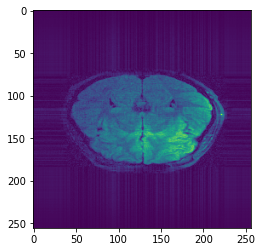

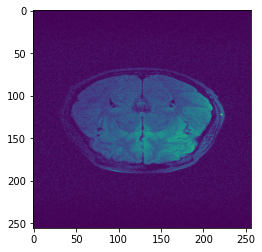

Time taken for epoch:  3.05241322517395
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in intorch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])


in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

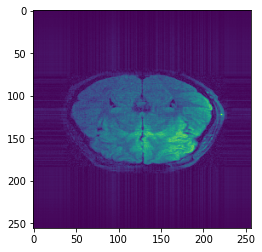

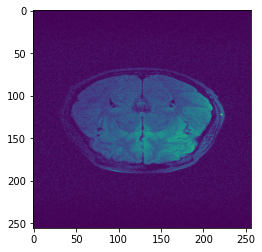

Time taken for epoch:  2.9550833702087402
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

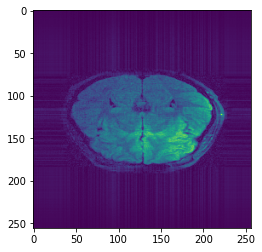

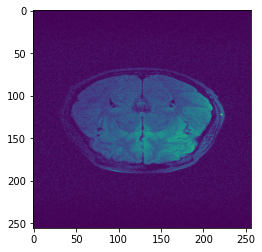

Time taken for epoch:  3.0807015895843506
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

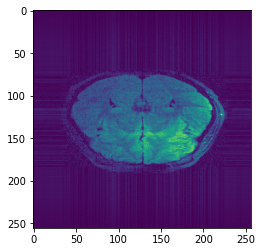

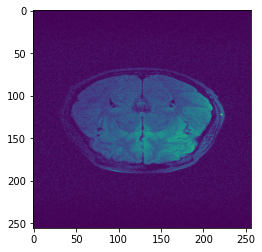

Time taken for epoch:  2.858767509460449
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 out2torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in in torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

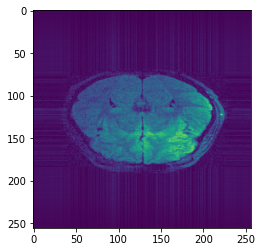

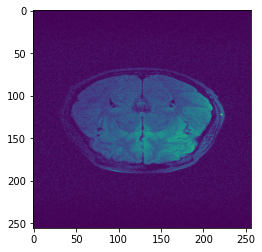

Time taken for epoch:  3.0298571586608887
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) 
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out out2torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

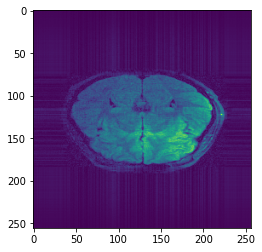

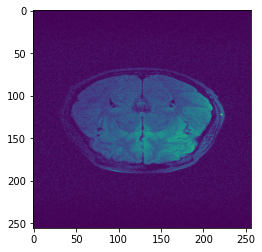

Time taken for epoch:  2.8864622116088867
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

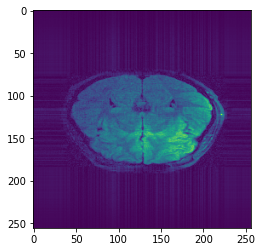

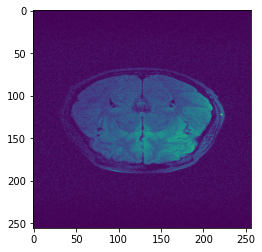

Time taken for epoch:  2.7994532585144043
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

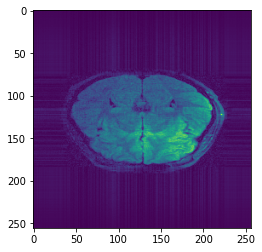

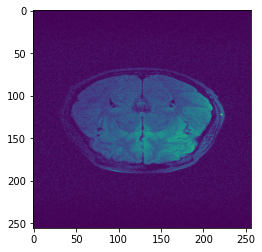

Time taken for epoch:  2.9905145168304443
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

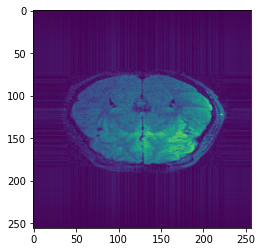

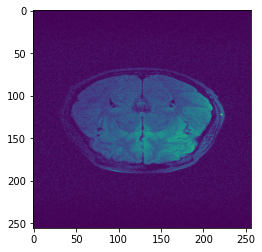

Time taken for epoch:  3.0544040203094482
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

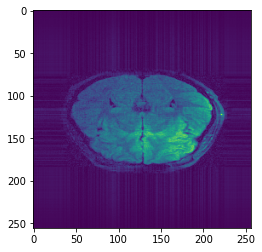

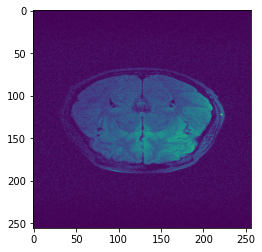

Time taken for epoch:  3.050151824951172
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 1, 256, 256])
 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])out2
 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

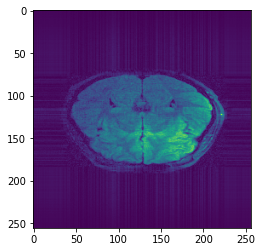

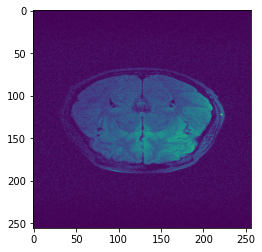

Time taken for epoch:  3.1049256324768066
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 to

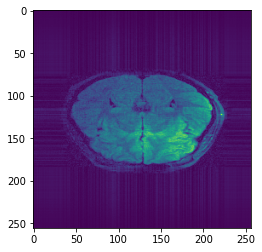

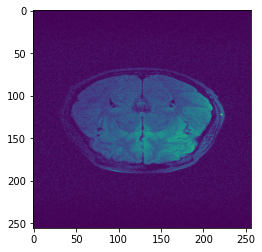

Time taken for epoch:  3.2232654094696045
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin  torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out to

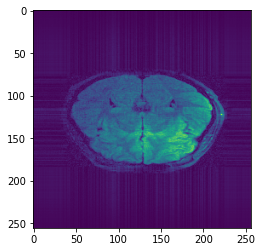

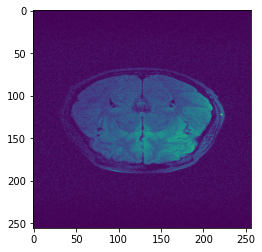

Time taken for epoch:  2.922395944595337
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

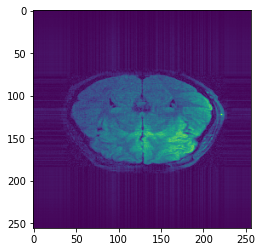

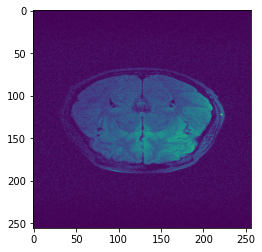

Time taken for epoch:  3.035130500793457
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2out2 torch.Size([8, 256, 256])
 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

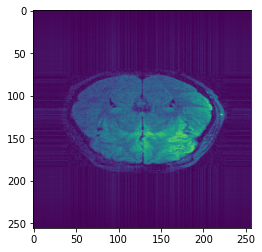

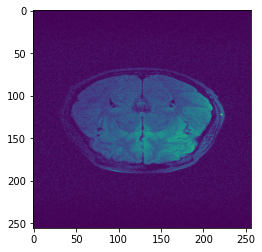

Time taken for epoch:  3.0698227882385254
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
torch.Size([8, 1, 256, 256])out2 torch.Size([8, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

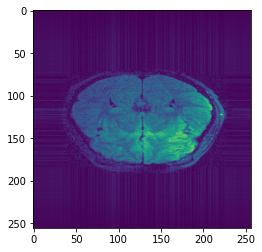

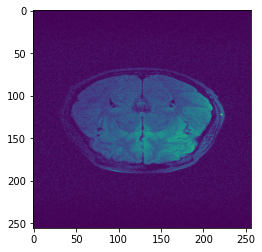

Time taken for epoch:  2.8846936225891113
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
inout2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

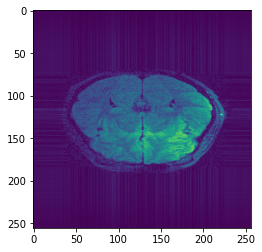

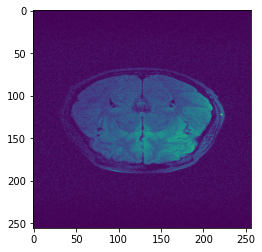

Time taken for epoch:  2.8625857830047607
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])in
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

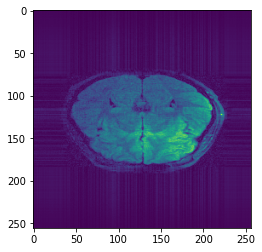

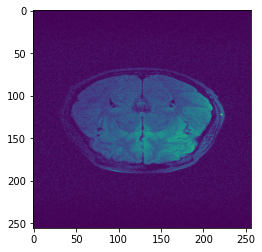

Time taken for epoch:  3.0281453132629395
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.

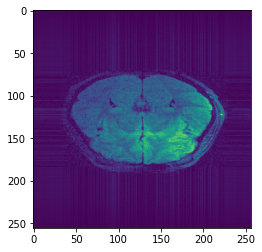

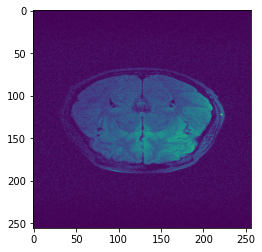

Time taken for epoch:  3.0106422901153564
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
in out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
 torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

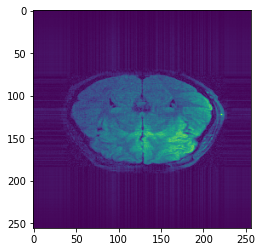

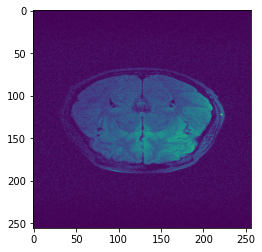

Time taken for epoch:  2.9955711364746094
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256]) torch.Size([8, 1, 256, 256])

out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

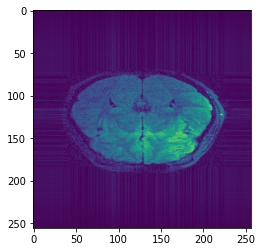

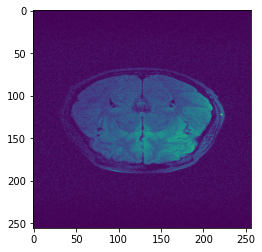

Time taken for epoch:  3.017204999923706
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
 out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

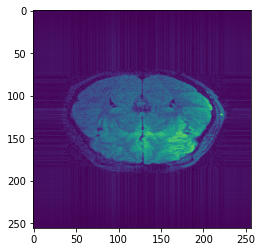

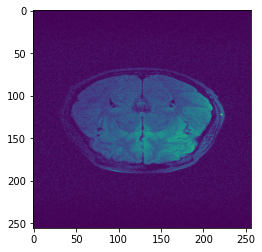

Time taken for epoch:  3.196462631225586
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

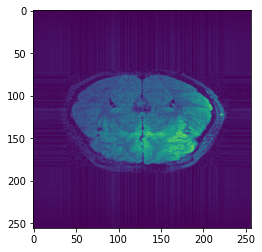

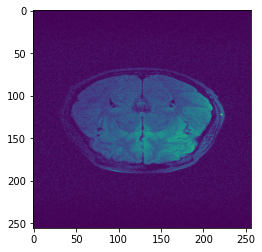

Time taken for epoch:  3.1202282905578613
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
inin torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
 out2 torch.Size([8, 256, 256])
torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torc

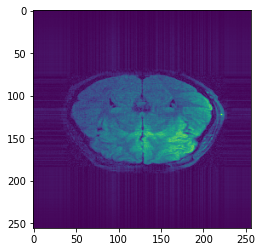

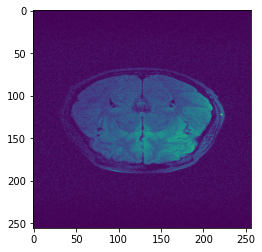

Time taken for epoch:  2.9678640365600586
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256])
in torch.Size([8, 1, 256, 256])
out torch.Size([8, 1, 256, 256])
out2 torch.Size([8, 256, 256]

In [ ]:
def train(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run

    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    logging.info(args)
    logging.info(model)

    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

        is_new_best = dev_loss < best_dev_loss
        best_dev_loss = min(best_dev_loss, dev_loss)
        save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
        print(f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} ',
        f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s')
        
        for iter, data in enumerate(train_loader):
            kspace, full = data
            input = kspace.to(f'{args.device}:{model.device_ids[0]}')
            target = full.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)
            #print(output)
            image=output.to('cpu').detach().numpy()
            plt.imshow(image[0,:,:])
            plt.show()
            plt.imshow(target[0,:,:].to('cpu').detach().numpy())
            plt.show()
            break;
        
        logging.info(
            f'Epoch = [{epoch:4d}/{args.num_epochs:4d}] TrainLoss = {train_loss:.4g} '
            f'DevLoss = {dev_loss:.4g} TrainTime = {train_time:.4f}s DevTime = {dev_time:.4f}s',
        )
        print("Time taken for epoch: ",time.time()-ti)
    writer.close()
    return dev_loss
    
train(args)

In [ ]:
#f ="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelue_2020/best_model.pt"
checkpoint, model, optimizer = load_model(args.checkpoint,args)
model.eval()

In [ ]:
for name, param in model.named_parameters():
    if param.requires_grad:
        print(name, param.data)
        plt.imshow(param.data.cpu(), vmin=-1, vmax=1, cmap='coolwarm')
        # Heat map of neuron weights
        plt.imshow(param.data.cpu(), vmin=np.min(param.data.cpu().numpy()), vmax=np.max(param.data.cpu().numpy()), cmap='coolwarm')
        plt.show()
        fig,ax=plt.subplots(320,1,figsize=(16,16))
        for i in range(320):
            ax[i].plot(param.data.cpu()[i,:320])
        plt.show()

In [ ]:
def train_plain(args): 
    args.exp_dir.mkdir(parents=True, exist_ok=True)
    writer = SummaryWriter(logdir=str(args.logdir)) #log directory for run
    if args.resume: #be aware of the option
        checkpoint, model, optimizer = load_model(args.checkpoint,args)
        args = checkpoint['args']
        best_dev_loss = checkpoint['best_dev_loss']
        #start_epoch = checkpoint['epoch']
        start_epoch = 0
        del checkpoint
    else:
        model = build_model(args)
        optimizer = build_optim(args, model.parameters())
        best_dev_loss = 1e9
        start_epoch = 0
    #train_loader,dev_loader,test_loader = create_data_loaders()
    scheduler = torch.optim.lr_scheduler.StepLR(optimizer, args.lr_step_size, args.lr_gamma)
    optimizer.step()

    for epoch in range(start_epoch, args.num_epochs):
        ti=time.time()
        scheduler.step(epoch)
        train_loss, train_time = train_epoch(args, epoch, model, train_loader, optimizer, writer)
        dev_loss, dev_time = evaluate(args, epoch, model, dev_loader, writer)
        #visualize(args, epoch, model, train_loader, writer)

#         is_new_best = dev_loss < best_dev_loss
#         best_dev_loss = min(best_dev_loss, dev_loss)
#         save_model(args, args.exp_dir, epoch, model, optimizer, best_dev_loss, is_new_best)
    writer.close()
    return dev_loss

def run_model(lr):
    print(lr)
    args.lr=lr
    return train_plain(args)

In [ ]:
from hyperopt import hp, tpe, fmin

# Single line bayesian optimization of polynomial function
args.num_epochs=100
best = fmin(fn=lambda x: run_model(x),
            space=hp.normal('x', 0.0001, 0.5),
            algo=tpe.suggest,
            max_evals=100)

In [ ]:
print(best)

In [ ]:
c="/mnt/mnt/5TB_slot2/Tobias/Thesis/FF_lrelu_pure_inverse_fourier/best_model.pt"
checkpoint, model, optimizer = load_model(c,args)
model.eval()
for iter, data in enumerate(train_loader):
            f, t = data
            plt.hist(f[abs(f) >= 0.00001].flatten(),bins=1000)
            plt.show()
            input = f.to(f'{args.device}:{model.device_ids[0]}')
            target = t.to(f'{args.device}:{model.device_ids[0]}')
            output = model(input).squeeze(1)
            image=output.to('cpu').squeeze(1).detach().numpy()
            #plt.plot(range(t[0].shape[0]),f[0][:320],color="red",linestyle="dashed")
            plt.plot(range(t[0].shape[0]),image[0].flatten())
            plt.plot(range(t[0].shape[0]),t[0],color="green",linestyle="dashed")
            plt.show()
            #break;